In [1]:
import cartopy.crs as ccrs
import geopandas as gpd
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import xarray as xr
from matplotlib import gridspec
from scipy import stats
from shapely.ops import unary_union

from data_utils import (
    get_lat_weights,
    rescaled_weights,
)
from meteo_utils import (
    heat_index_celsius,
    kelvin_to_celsius,
    relative_humidity_from_specific_humidity_and_pressure_and_temperature,
    relative_humidity_from_temperature_and_dew_point_temperature,
)
from plot_utils import add_headers

# Studying the 2023 South Asian Humid Heat Wave

## NOAA heat index:

The WWA Study by Zachariah et all uses the NOAA heat index. In the following, a short overview over the equations, implementation is in meteo_utils.py

inputs: relative humidity $R$, and temperature $T$ in Fahrenheit! 
output: "apparent heat in degrees Fahrenheit"

use

$HI = -42.379 + 2.04901523*T + 10.14333127*R - .22475541*T*R - .00683783*T*T - .05481717*R*R + .00122874*T*T*R + .00085282*T*R*R - .00000199*T*T*R*R$

$HI - HI_{A1}$ if $R < 13%$ AND $80°F < T < 112°F$

$HI + HI_{A2}$ if $R < 85%$ AND $80°F < T < 87°F$

$HI$ otherwise.

$HI_{A1} = (13-R)/4 * \sqrt{((17 - |T-95|)/17)}$

$HI_{A2} = (R - 85) / 10 * (87-T)/5$

$HI = 0.5 (T + 61 + 1.2(T-68) + 0.094R)$ if $HI < 80 F$


In practice: first compute last equation, take average with temperature. If value $> 80F$ apply the complicated formula with corrections

Heat index is then converted to degrees celsius.

### Computing relative humidity from dew point temperature and temperature:

compute relative humidity as the ratio of saturation water pressure at dew point temperature to saturation water pressure at the actual temperature.

$R =e^\frac{b * T_D}{l + T_d} / e^\frac{b * T}{l + T}$

where $b=17.625$, $l=243.04°C$ (August-Roche-Magnus)

### Convert from specific humidity to relative humidity

Specific humidity $q$, relative humidity $r$

$r = q/(1-q)/w_s$

$w_s$, mixing ratio at saturation

$w_s = 0.622 \frac{e_s}{p-e_s}$

$p$: Pressure, $e_s$: Saturation water pressure.

In [ ]:
# plotting helper function
def add_label_to_axes(ax, label, xpos=0.04, ypos=0.95):
    ax.text(
        xpos,
        ypos,
        label,
        ha="left",
        va="top",
        bbox={
            "facecolor": "white",
            "edgecolor": "none",
            "boxstyle": "square",
            "pad": 0.1,
        },
        transform=ax.transAxes,
    )


letters = ["A", "B", "C", "D", "E", "F", "G"]

In [3]:
# some plotting setup
plt.rcParams.update({"font.size": 8})
plt.rcParams["figure.dpi"] = 300
plt.style.use("tableau-colorblind10")
alphabet_letters = np.array(
    list(map(chr, range(65, 91)))
)  # used for labelling subplots
textwidth = 144  # in mm
mm_to_inch = 0.0393701
textwidth = textwidth * mm_to_inch  # textwidth in inches

# modify color cycle - exclude greys.
color_cycle = plt.rcParams["axes.prop_cycle"].by_key()["color"]
excluded_colors = [color_cycle[2], color_cycle[3], color_cycle[6]]
new_color_cycle = [color for color in color_cycle if color not in excluded_colors]
plt.rcParams["axes.prop_cycle"] = plt.cycler("color", new_color_cycle)

In [4]:
# some study setup.

# define bounding boxes for india and bangladesh + thailand / laos region
box_india_bangladesh = {"latitude": slice(7, 27), "longitude": slice(72, 94)}
box_laos_thailand = {"latitude": slice(5, 23), "longitude": slice(97, 109)}


labels_countries = ["India-Bangladesh", "Laos-Thailand"]
labels_humidities = [-1, 1000, 850]  # -1 is used to label surface level
humidities_title_labels = {1000: "1000hPa", 850: "850hPa", -1: "surface"}

slices = [
    slice(
        np.datetime64("2023-04-17T00:00:00.000000000"),
        np.datetime64("2023-04-20T23:00:00.000000000"),
    ),
    slice(
        np.datetime64("2023-04-18T00:00:00.000000000"),
        np.datetime64("2023-04-21T23:00:00.000000000"),
    ),
]

grid = xr.DataArray(
    dims=("latitude", "longitude"),
    coords={
        "latitude": np.arange(-90, 90.25, 0.25),
        "longitude": np.arange(0, 360, 0.25),
    },
)

boxes = [box_india_bangladesh, box_laos_thailand]

inner_bounds = np.array([27, 32, 41, 54])
bounds = np.array([20, 27, 32, 41, 54, 60])
colors = np.array(["#d9d9d9", "#bdbdbd", "#969696", "#636363", "#252525"])

labels = ["Low Risk", "Caution", "Extreme Caution", "Danger", "Extreme Danger"]

## Loading data

In [5]:
gt_data = xr.open_dataset("data/2023_SA_humid_heatwave_gt.nc").chunk({"time": 5})
fc_data = xr.open_dataset("data/2023_SA_humid_heatwave_fc.nc").chunk({"time": 5})

## Recreate plots from Zachariah et al.

In [6]:
def mean_daily_max(
    ds: xr.Dataset | xr.DataArray, dim_name: str = "time"
) -> xr.Dataset | xr.DataArray:
    """Aggregate data temporally by taking the daily maximum and averaging over dates.

    Args:
    ----
        ds (xr.Dataset | xr.DataArray): Object the temporal agregation should be applied to.
        dim_name (str, optional): Name of the dimension to apply this to. Defaults to "time".

    Returns:
    -------
        _type_: Object with applied aggregation.

    """
    return ds.groupby(f"{dim_name}.date").max().mean(dim="date")


def mean_daily_min(
    ds: xr.Dataset | xr.DataArray, dim_name: str = "time"
) -> xr.Dataset | xr.DataArray:
    """Aggregate data temporally by taking the daily minimum and averaging over dates.

    Args:
    ----
        ds (xr.Dataset | xr.DataArray):  Object the temporal agregation should be applied to.
        dim_name (str, optional): Name of the dimension to apply this to. Defaults to "time".

    Returns:
    -------
        xr.Dataset | xr.DataArray: Object with applied aggregation.

    """
    return ds.groupby(f"{dim_name}.date").min().mean(dim="date")


def mean_daily_fixed_timeofday(
    ds: xr.Dataset | xr.DataArray, hour: int, dim_name: str = "time"
) -> xr.Dataset | xr.DataArray:
    """Aggregate data temporally by taking the daily minimum and averaging over dates.

    Args:
    ----
        ds (xr.Dataset | xr.DataArray):  Object the temporal agregation should be applied to.
        hour (int): Hour of day to be evaluated.
        dim_name (str, optional): Name of the dimension to apply this to. Defaults to "time".

    Returns:
    -------
        xr.Dataset | xr.DataArray: Object with applied aggregation.

    """
    return ds.where(ds.time.dt.hour == hour, drop=True).mean(dim_name)


def mean_at_time_of_daily_hi_max(
    ds: xr.Dataset | xr.DataArray, hi_gt: xr.DataArray, dim_name: str = "time"
) -> xr.Dataset | xr.DataArray:
    """First extract the value of the given variable at the time of maximum heat index on each day. Then average over all days.

    Args:
        ds (xr.Dataset | xr.DataArray): Data to be aggregated
        hi_gt (xr.DataArray): Heat index value that are used to compute the time of maximum daily HI
        dim_name (str, optional): The name of the time dimension. Defaults to "time".

    Returns:
        xr.Dataset | xr.DataArray: Aggregated data.

    """
    gs = hi_gt.groupby(f"{dim_name}.date")

    res = []
    for g in gs:
        res.append(g[1].idxmax(f"{dim_name}").to_numpy())
    I_dates = xr.DataArray(np.array(res), dims=hi_gt.dims)

    return ds.sel({f"{dim_name}": I_dates}).mean(f"{dim_name}")


def mean_at_time_of_daily_hi_min(
    ds: xr.Dataset | xr.DataArray, hi_gt: xr.DataArray, dim_name: str = "time"
) -> xr.Dataset | xr.DataArray:
    """First extract the value of the given variable at the time of minimum heat index on each day. Then average over all days.

    Args:
        ds (xr.Dataset | xr.DataArray): Data to be aggregated
        hi_gt (xr.DataArray): Heat index values that are used to compute the time of minimum daily HI
        dim_name (str, optional): The name of the time dimension. Defaults to "time".

    Returns:
        xr.Dataset | xr.DataArray: Aggregated data.

    """
    gs = hi_gt.groupby(f"{dim_name}.date")

    res = []
    for g in gs:
        res.append(g[1].idxmin(f"{dim_name}").to_numpy())
    I_dates = xr.DataArray(np.array(res), dims=hi_gt.dims)

    return ds.sel({f"{dim_name}": I_dates}).mean(f"{dim_name}")

In [7]:
def get_time_of_daily_hi_max(
    hi_gt: xr.Dataset | xr.DataArray, dim_name: str = "time"
) -> xr.DataArray:
    """Extract the timesteps during which the heat index is maximal.

    Args:
        hi_gt (xr.Dataset | xr.DataArray): Heat index data.
        dim_name (str, optional): Name of the time dimension. Defaults to "time".

    Returns:
        xr.DataArray: Time steps of daily maximum heat index.

    """
    gs = hi_gt.groupby(f"{dim_name}.date")

    res = []
    for g in gs:
        res.append(g[1].idxmax(f"{dim_name}").to_numpy())
    return xr.DataArray(np.array(res), dims=hi_gt.dims)

In [8]:
# in a slight misuse of notation, I reuse the "level" coordinate to indicate how the relative humidity has been computed NOT where HI is valid!

gt_data["relative_humidity"] = xr.DataArray(
    coords=dict(gt_data["2m_temperature"].coords),
    dims=list(gt_data["2m_temperature"].dims),
).chunk({"time": 5})

gt_data["heat_index"] = xr.DataArray(
    coords=dict(gt_data["2m_temperature"].coords),
    dims=list(gt_data["2m_temperature"].dims),
).chunk({"time": 5})

fc_data["relative_humidity"] = xr.DataArray(
    coords=dict(fc_data["temperature"].coords),
    dims=list(fc_data["temperature"].dims),
).chunk({"time": 5})


coords = dict(fc_data["temperature"].coords)

fc_data["heat_index"] = xr.DataArray(
    coords=dict(fc_data["temperature"].coords),
    dims=list(fc_data["temperature"].dims),
).chunk({"time": 5})

In [9]:
gt_data["relative_humidity"].loc[{"level": -1}] = (
    relative_humidity_from_temperature_and_dew_point_temperature(
        T=kelvin_to_celsius(gt_data["2m_temperature"]).sel(level=-1),
        T_d=kelvin_to_celsius(gt_data["2m_dewpoint_temperature"]).sel(level=-1),
    )
)

for p in [850, 1000]:
    gt_data["relative_humidity"].loc[{"source": "ERA5", "level": p}] = (
        relative_humidity_from_specific_humidity_and_pressure_and_temperature(
            q=gt_data.sel({"source": "ERA5", "level": p})["specific_humidity"],
            p=p,
            T=kelvin_to_celsius(
                gt_data.sel({"source": "ERA5", "level": p})["temperature"]
            ),
        )
    )
    gt_data["relative_humidity"].loc[{"source": "HRES_t0", "level": p}] = (
        relative_humidity_from_specific_humidity_and_pressure_and_temperature(
            q=gt_data.sel({"source": "HRES_t0", "level": p})["specific_humidity"],
            p=p,
            T=kelvin_to_celsius(
                gt_data.sel({"source": "HRES_t0", "level": p})["temperature"]
            ),
        )
    )

gt_data["heat_index"].loc[{"level": -1}] = heat_index_celsius(
    T=kelvin_to_celsius(gt_data["2m_temperature"].sel(level=-1)),
    R=gt_data["relative_humidity"].sel(level=-1),
)

for p in [850, 1000]:
    gt_data["heat_index"].loc[{"source": "ERA5", "level": p}] = heat_index_celsius(
        T=kelvin_to_celsius(gt_data["2m_temperature"].sel(source="ERA5", level=-1)),
        R=gt_data["relative_humidity"].sel(source="ERA5", level=p),
    )
    gt_data["heat_index"].loc[{"source": "HRES_t0", "level": p}] = heat_index_celsius(
        T=kelvin_to_celsius(gt_data["2m_temperature"].sel(source="HRES_t0", level=-1)),
        R=gt_data["relative_humidity"].sel(source="HRES_t0", level=p),
    )

In [10]:
fc_data["relative_humidity"].loc[{"forecast": "HRES", "level": -1}] = (
    relative_humidity_from_temperature_and_dew_point_temperature(
        T=kelvin_to_celsius(fc_data["2m_temperature"]).sel(level=-1, forecast="HRES"),
        T_d=kelvin_to_celsius(fc_data["2m_dewpoint_temperature"]).sel(
            level=-1, forecast="HRES"
        ),
    )
)


for p in [850, 1000]:
    for fc in ["GraphCast", "PanguWeather", "HRES"]:
        fc_data["relative_humidity"].loc[{"forecast": fc, "level": p}] = (
            relative_humidity_from_specific_humidity_and_pressure_and_temperature(
                q=fc_data.sel({"forecast": fc, "level": p})["specific_humidity"],
                p=p,
                T=kelvin_to_celsius(
                    fc_data.sel({"forecast": fc, "level": p})["temperature"]
                ),
            )
        )

fc_data["heat_index"].loc[{"forecast": "HRES", "level": -1}] = heat_index_celsius(
    T=kelvin_to_celsius(fc_data["2m_temperature"].sel(forecast="HRES", level=-1)),
    R=fc_data["relative_humidity"].sel(forecast="HRES", level=-1),
)

for p in [850, 1000]:
    for fc in ["GraphCast", "PanguWeather", "HRES"]:
        fc_data["heat_index"].loc[{"forecast": fc, "level": p}] = heat_index_celsius(
            T=kelvin_to_celsius(fc_data["2m_temperature"].sel(forecast=fc, level=-1)),
            R=fc_data["relative_humidity"].sel(forecast=fc, level=p),
        )

/home/wider/.conda/envs/climate_eval/lib/python3.13/site-packages/dask/_task_spec.py:651: RuntimeWarning: invalid value encountered in sqrt
  return self.func(*new_argspec)
/home/wider/.conda/envs/climate_eval/lib/python3.13/site-packages/dask/_task_spec.py:651: RuntimeWarning: invalid value encountered in sqrt
  return self.func(*new_argspec)
/home/wider/.conda/envs/climate_eval/lib/python3.13/site-packages/dask/_task_spec.py:651: RuntimeWarning: invalid value encountered in sqrt
  return self.func(*new_argspec)
/home/wider/.conda/envs/climate_eval/lib/python3.13/site-packages/dask/_task_spec.py:651: RuntimeWarning: invalid value encountered in sqrt
  return self.func(*new_argspec)
/home/wider/.conda/envs/climate_eval/lib/python3.13/site-packages/dask/_task_spec.py:651: RuntimeWarning: invalid value encountered in sqrt
  return self.func(*new_argspec)
/home/wider/.conda/envs/climate_eval/lib/python3.13/site-packages/dask/_task_spec.py:651: RuntimeWarning: invalid value encountered in 

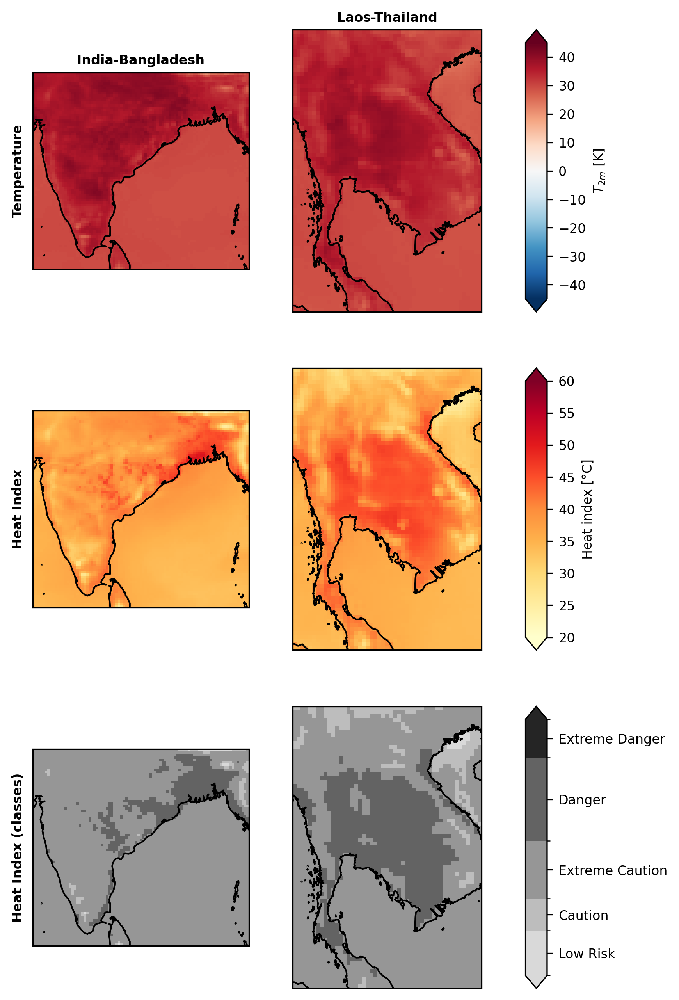

In [11]:
# plot ERA5 stats.

aspect_ratio_single_plot = 0.8

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 3 / 2))

gs = gridspec.GridSpec(3, 3, figure=fig, width_ratios=[1, 1, 0.1])

for i, (box, time_slice) in enumerate(zip(boxes, slices, strict=True)):
    hi_gt = (
        gt_data["heat_index"]
        .sel(source="ERA5", level=-1)
        .sel({"time": time_slice, **box})
    )

    mean_hi_daily_max = mean_at_time_of_daily_hi_max(
        gt_data["heat_index"]
        .sel(source="ERA5", level=-1)
        .sel({"time": time_slice, **box}),
        hi_gt=hi_gt,
    )

    mean_t2m_daily_max = mean_at_time_of_daily_hi_max(
        gt_data["2m_temperature"]
        .sel(source="ERA5", level=-1)
        .sel({"time": time_slice, **box}),
        hi_gt=hi_gt,
    )

    # temperatures
    ax = fig.add_subplot(gs[0, i], projection=ccrs.PlateCarree())
    im_t2m = kelvin_to_celsius(mean_t2m_daily_max).plot(
        ax=ax,
        cmap="RdBu_r",
        vmax=45,
        vmin=-45,
        add_colorbar=False,
    )
    ax.coastlines()
    ax.set_title("")

    # heat index
    ax = fig.add_subplot(gs[1, i], projection=ccrs.PlateCarree())
    im_hi = mean_hi_daily_max.plot(
        ax=ax,
        cmap="YlOrRd",
        vmax=60,
        vmin=20,
        add_colorbar=False,
    )
    ax.coastlines()
    ax.set_title("")

    # heat index danger levels
    ax = fig.add_subplot(gs[2, i], projection=ccrs.PlateCarree())
    cmap = matplotlib.colors.ListedColormap(colors)
    norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)
    ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
    fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])

    im_hi_classes = mean_hi_daily_max.plot(
        ax=ax,
        cmap=cmap,
        norm=norm,
        add_colorbar=False,
    )
    ax.coastlines()
    ax.set_title("")

add_headers(
    fig=fig,
    col_headers=labels_countries,
    row_headers=["Temperature", "Heat Index", "Heat Index (classes)"],
    fontweight="bold",
)


ax_cb_t2m = plt.subplot(gs[0, -1])
cbar = plt.colorbar(mappable=im_t2m, cax=ax_cb_t2m, extend="both", label="$T_{2m}$ [K]")

ax_cb_hi = plt.subplot(gs[1, -1])
cbar = plt.colorbar(
    mappable=im_hi, cax=ax_cb_hi, extend="both", label="Heat index [°C]"
)

ax_cb_hi_classes = plt.subplot(gs[2, -1])
cbar = plt.colorbar(
    mappable=im_hi_classes,
    cax=ax_cb_hi_classes,
    extend="both",
    spacing="proportional",
    ticks=ticks,
    format=fmt,
)

plt.savefig("images/2023_humid_heatwave_overview.png")

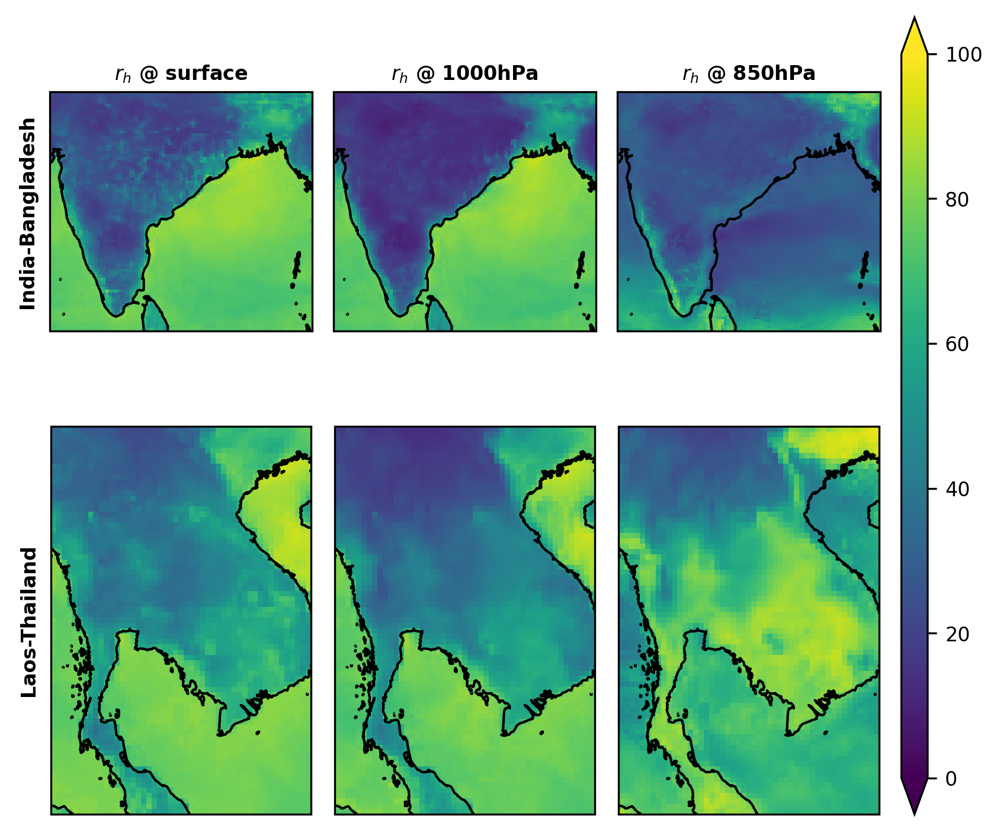

In [12]:
aspect_ratio_single_plot = 0.8

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 2 / 3))

gs = gridspec.GridSpec(
    2,
    4,
    figure=fig,
    width_ratios=[1, 1, 1, 0.1],
)

for i, (box, time_slice) in enumerate(zip(boxes, slices, strict=False)):
    for j, l_h in enumerate(labels_humidities):
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=-1)
            .sel({"time": time_slice, **box})
        )
        ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
        m = mean_at_time_of_daily_hi_max(
            gt_data["relative_humidity"]
            .sel({"source": "ERA5", "level": l_h})
            .sel({"time": time_slice, **box}),
            hi_gt=hi_gt,
        ).plot(ax=ax, vmin=0, vmax=100, add_colorbar=False)
        ax.coastlines()
        ax.set_title("")

add_headers(
    fig=fig,
    row_headers=labels_countries,
    col_headers=[
        f"$r_h$ @ {humidities_title_labels[l_h]}" for l_h in labels_humidities
    ],
    fontweight="bold",
)

ax_cb = plt.subplot(gs[:, 3])
ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
cbar = plt.colorbar(mappable=m, cax=ax_cb, extend="both")

plt.tight_layout()
plt.savefig("images/2023_humid_heatwave_relative_humidity.png")

### Compute heat index with different relative humidity products

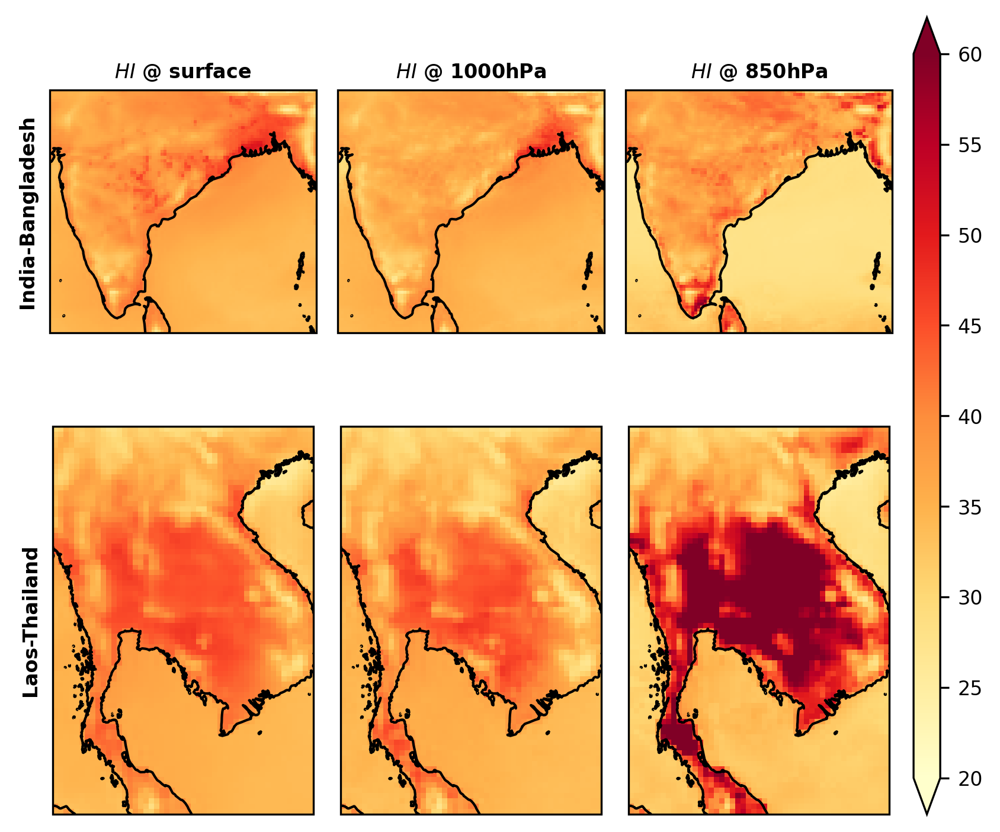

In [13]:
aspect_ratio_single_plot = 0.8

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 2 / 3))

gs = gridspec.GridSpec(
    2,
    4,
    figure=fig,
    width_ratios=[1, 1, 1, 0.1],
)

for i, (box, time_slice) in enumerate(zip(boxes, slices, strict=False)):
    for j, l_h in enumerate(labels_humidities):
        ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=-1)
            .sel({"time": time_slice, **box})
        )
        m = mean_at_time_of_daily_hi_max(
            gt_data["heat_index"]
            .sel({"source": "ERA5", "level": l_h})
            .sel({"time": time_slice, **box}),
            hi_gt=hi_gt,
        ).plot(ax=ax, cmap="YlOrRd", vmax=60, vmin=20, add_colorbar=False)
        ax.coastlines()
        ax.set_title("")

add_headers(
    fig=fig,
    row_headers=labels_countries,
    col_headers=[f"$HI$ @ {humidities_title_labels[l_h]}" for l_h in labels_humidities],
    fontweight="bold",
)

ax_cb = plt.subplot(gs[:, 3])
ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
cbar = plt.colorbar(mappable=m, cax=ax_cb, extend="both")

plt.tight_layout()
plt.savefig("images/2023_humid_heatwave_heat_index_varying_sources.png")

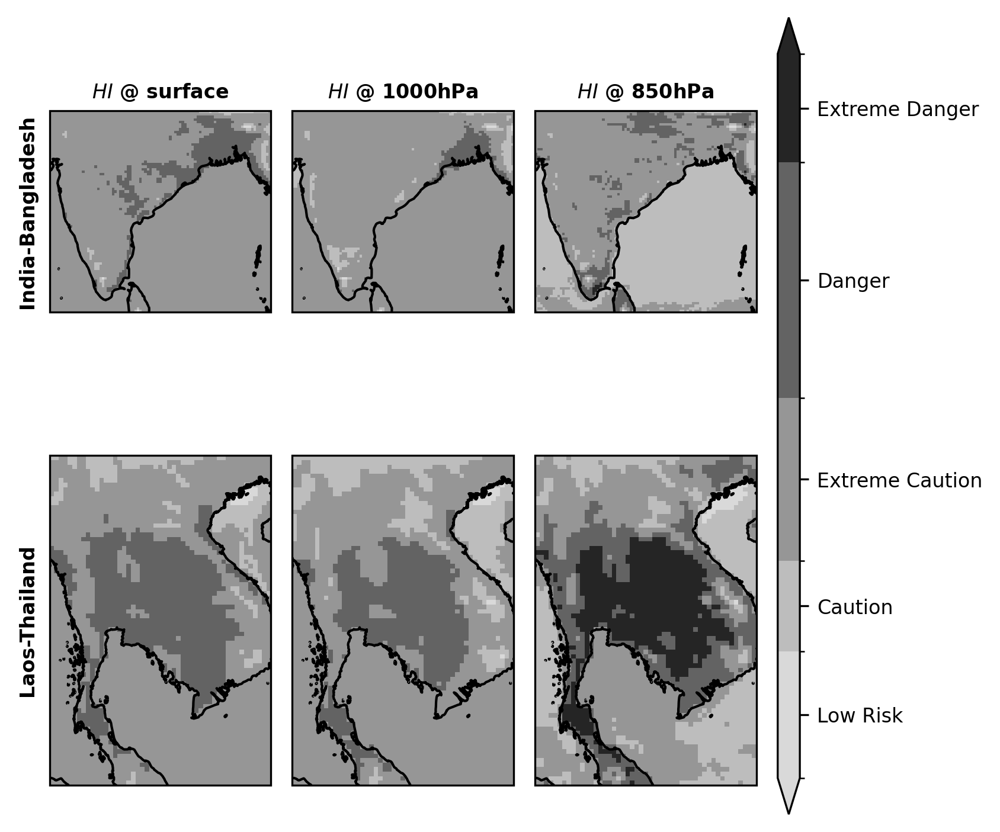

In [14]:
aspect_ratio_single_plot = 0.8

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 2 / 3))

gs = gridspec.GridSpec(
    2,
    4,
    figure=fig,
    width_ratios=[1, 1, 1, 0.1],
)

# heat index danger levels
cmap = matplotlib.colors.ListedColormap(colors)
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

for i, (box, time_slice) in enumerate(zip(boxes, slices, strict=False)):
    for j, l_h in enumerate(labels_humidities):
        ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=-1)
            .sel({"time": time_slice, **box})
        )
        m = mean_at_time_of_daily_hi_max(
            gt_data["heat_index"]
            .sel({"source": "ERA5", "level": l_h})
            .sel({"time": time_slice, **box}),
            hi_gt=hi_gt,
        ).plot(ax=ax, cmap=cmap, norm=norm, add_colorbar=False)
        ax.coastlines()
        ax.set_title("")

add_headers(
    fig=fig,
    row_headers=labels_countries,
    col_headers=[f"$HI$ @ {humidities_title_labels[l_h]}" for l_h in labels_humidities],
    fontweight="bold",
)

ax_cb = plt.subplot(gs[:, 3])
ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
cbar = plt.colorbar(
    mappable=m,
    cax=ax_cb,
    format=fmt,
    ticks=ticks,
    extend="both",
    spacing="proportional",
)

plt.tight_layout()
plt.savefig("images/2023_humid_heatwave_heat_index_varying_sources_cm_discrete.png")

# Shape files.


We downloaded two shapefiles: one with country boundaries and one with climate zones. For the Thailand-Laos region, we only use the Country boundary one, for India-Bangladesh, we use both.

In [15]:
# load shapefiles.

# downloaded from https://public.opendatasoft.com/explore/dataset/world-administrative-boundaries/information/ - or sth similar I can't find the exact address.
shapefile_countries = "Shapefiles/countries.geojson"

# downloaded from https://datacatalog.worldbank.org/search/dataset/0042325
shapefile_climate_zones = "Shapefiles/climate_zones/c1976_2000_0/c1976_2000.shp"  # http://koeppen-geiger.vu-wien.ac.at/data/legend.txt

shp_climate = gpd.read_file(shapefile_climate_zones)
shp_countries = gpd.read_file(shapefile_countries)

In [16]:
def clip_data(
    data: xr.DataArray | xr.Dataset, mask: gpd.GeoDataFrame
) -> xr.DataArray | xr.Dataset:
    """Clip xarray data, data outside of gpd.GeoDataFrame is set to nan.

    Args:
        data (xr.DataArray | xr.Dataset): Data to be clipped
        mask (gpd.GeoDataFrame): Mask to be applied

    Returns:
        xr.DataArray | xr.Dataset: Clipped dataset. Values outside selection are set to np.nan

    """
    data.rio.set_spatial_dims(x_dim="longitude", y_dim="latitude", inplace=True)
    data.rio.write_crs(
        "epsg:4326", inplace=True
    )  # this is the standard crs (Coordinate Reference System)
    return data.rio.clip(mask.geometry, mask.crs, drop=False)

### Laos and Thailand:

Start with the slightly simpler case: Laos and Thailand

In [17]:
laos_mask = shp_countries[
    shp_countries["french_short"] == "République démocratique populaire lao"
].geometry
thailand_mask = shp_countries[shp_countries["french_short"] == "Thaïlande"].geometry
laos_thailand_mask = gpd.GeoDataFrame(
    geometry=[unary_union([laos_mask, thailand_mask])]
)

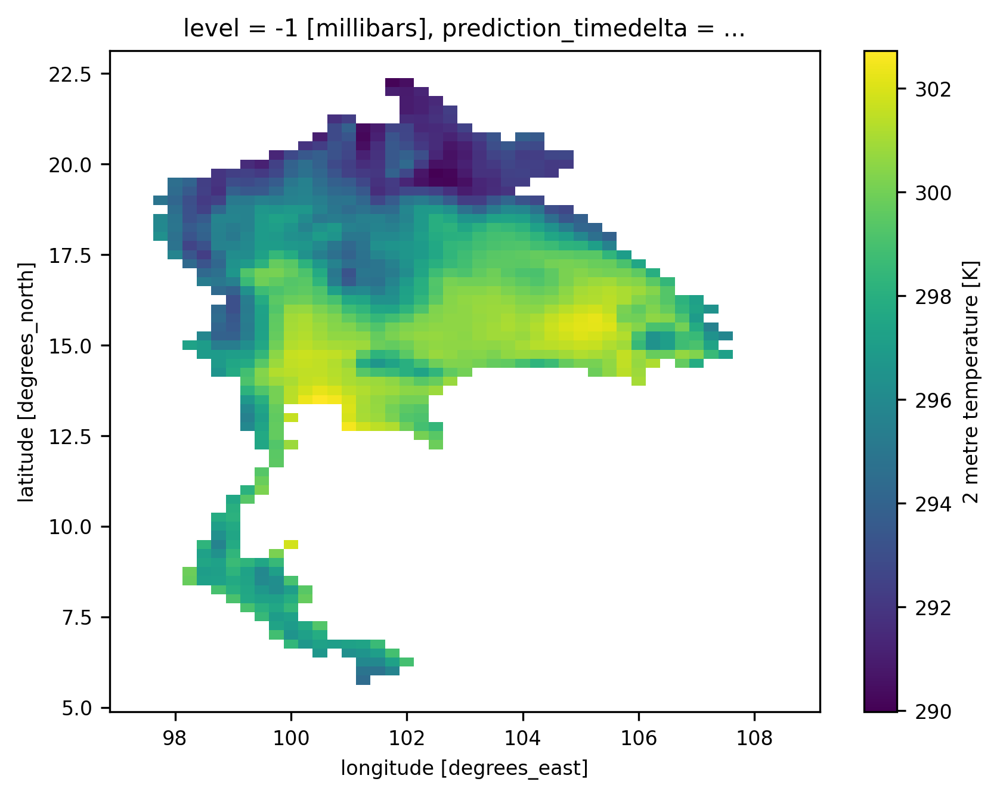

In [18]:
# clip ERA5
clipped_laos_thailand_sfc = clip_data(
    data=gt_data.sel(source="ERA5", level=-1)["2m_temperature"].sel(boxes[1]),
    mask=laos_thailand_mask,
)
clipped_laos_thailand_sfc.isel(time=0).plot()
plt.savefig("images/2023_humid_heatwave_shapefile_laos_thailand.png")
plt.show()

### India and Bangladesh:

This case is a bit harder because we need to cut out climate zones that were not affected as badly by the heat wave.

In [19]:
india_mask = shp_countries[shp_countries["french_short"] == "Inde"].geometry
bangladesh_mask = shp_countries[shp_countries["french_short"] == "Bangladesh"].geometry
india_bangladesh_mask = gpd.GeoDataFrame(
    geometry=[unary_union([india_mask, bangladesh_mask])]
).set_crs("epsg:4326")

We want to excluded climate zones that are not affected by the dry humid heat wave. Therefore we restrict the valid classes to ones in Köppen-Geiger Class A (Tropical), similar to what WWA did.


In [20]:
cutout = gpd.GeoDataFrame(
    geometry=[
        unary_union(
            shp_climate[shp_climate["GRIDCODE"].isin(np.arange(10, 21))]
            .to_crs("epsg:4326")
            .geometry
        )
    ]
).set_crs("epsg:4326")
mp = india_bangladesh_mask.geometry.intersection(
    cutout, align=True
).to_numpy()[
    0
]  # only select the largest polygon - there are quite a lot of small left over ones that get produced
india_bangladesh_climate_mask = gpd.GeoDataFrame(
    geometry=[max(mp.geoms, key=lambda polygon: polygon.area)]
).set_crs("epsg:4326")

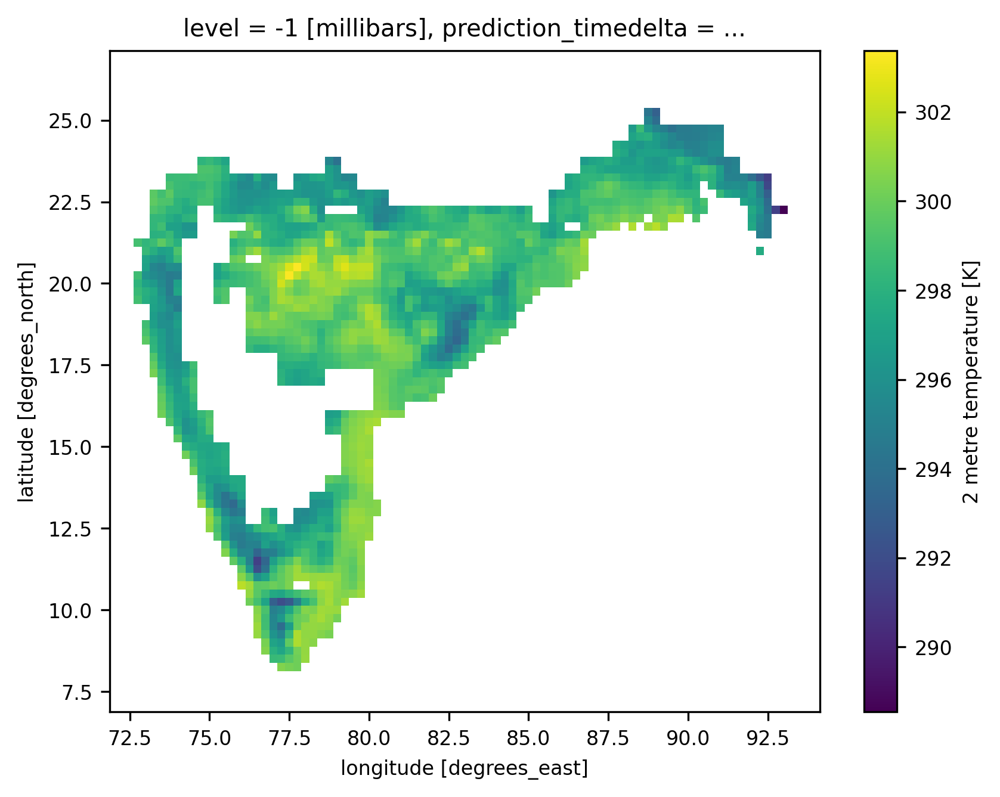

In [21]:
# clip ERA5
clipped_india_bangladesh_sfc = clip_data(
    data=gt_data.sel(source="ERA5", level=-1)["2m_temperature"].sel(boxes[0]),
    mask=india_bangladesh_climate_mask,
)
clipped_india_bangladesh_sfc.isel(time=0).plot()
plt.savefig("images/2023_humid_heatwave_shapefile_india_bangladesh.png")
plt.show()

## Cut-out the Heat-Index maps:

In [22]:
masks = [india_bangladesh_climate_mask, laos_thailand_mask]

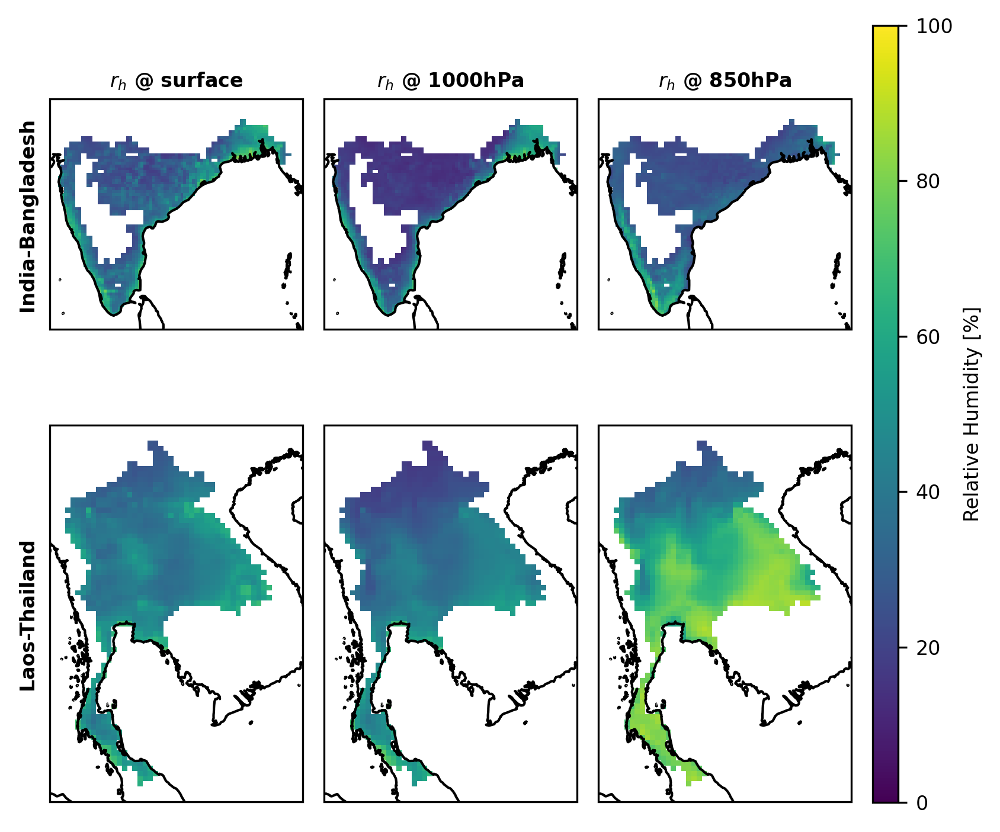

In [23]:
aspect_ratio_single_plot = 0.8

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 2 / 3))

gs = gridspec.GridSpec(
    2,
    4,
    figure=fig,
    width_ratios=[1, 1, 1, 0.1],
)


for i, (box, time_slice, mask) in enumerate(zip(boxes, slices, masks, strict=False)):
    for j, l_h in enumerate(labels_humidities):
        ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=-1)
            .sel({"time": time_slice, **box})
        )
        m = clip_data(
            mean_at_time_of_daily_hi_max(
                gt_data["relative_humidity"]
                .sel({"source": "ERA5", "level": l_h})
                .sel({"time": time_slice, **box}),
                hi_gt=hi_gt,
            ),
            mask=mask,
        ).plot(ax=ax, vmin=0, vmax=100, add_colorbar=False)
        ax.coastlines()
        ax.set_title("")

add_headers(
    fig=fig,
    row_headers=labels_countries,
    col_headers=[
        f"$r_h$ @ {humidities_title_labels[l_h]}" for l_h in labels_humidities
    ],
    fontweight="bold",
)

ax_cb = plt.subplot(gs[:, 3])
cbar = plt.colorbar(mappable=m, cax=ax_cb, label="Relative Humidity [%]")

plt.tight_layout()
plt.savefig("images/2023_humid_heatwave_relative_humidity_cutout.png")

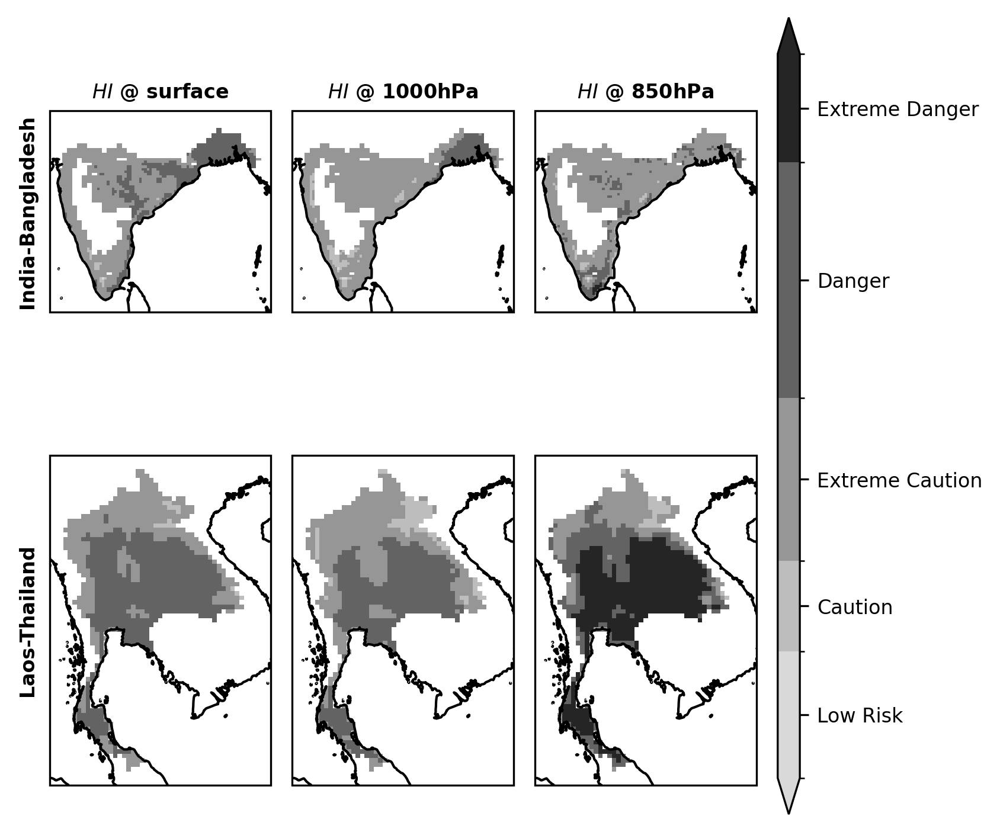

In [24]:
# same but using the categorical heat index.
aspect_ratio_single_plot = 0.8

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 2 / 3))

gs = gridspec.GridSpec(
    2,
    4,
    figure=fig,
    width_ratios=[1, 1, 1, 0.1],
)

# heat index danger levels
cmap = matplotlib.colors.ListedColormap(colors)
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

for i, (box, time_slice, mask) in enumerate(zip(boxes, slices, masks, strict=False)):
    for j, l_h in enumerate(labels_humidities):
        ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=-1)
            .sel({"time": time_slice, **box})
        )
        m = clip_data(
            mean_at_time_of_daily_hi_max(
                gt_data["heat_index"]
                .sel({"source": "ERA5", "level": l_h})
                .sel({"time": time_slice, **box}),
                hi_gt=hi_gt,
            ),
            mask=mask,
        ).plot(ax=ax, cmap=cmap, norm=norm, add_colorbar=False)
        ax.coastlines()
        ax.set_title("")

add_headers(
    fig=fig,
    row_headers=labels_countries,
    col_headers=[f"$HI$ @ {humidities_title_labels[l_h]}" for l_h in labels_humidities],
    fontweight="bold",
)

ax_cb = plt.subplot(gs[:, 3])
ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
cbar = plt.colorbar(
    mappable=m,
    cax=ax_cb,
    format=fmt,
    ticks=ticks,
    extend="both",
    spacing="proportional",
)

plt.tight_layout()

plt.savefig("images/2023_humid_heatwave_hi_cutout_cm_discrete.png")

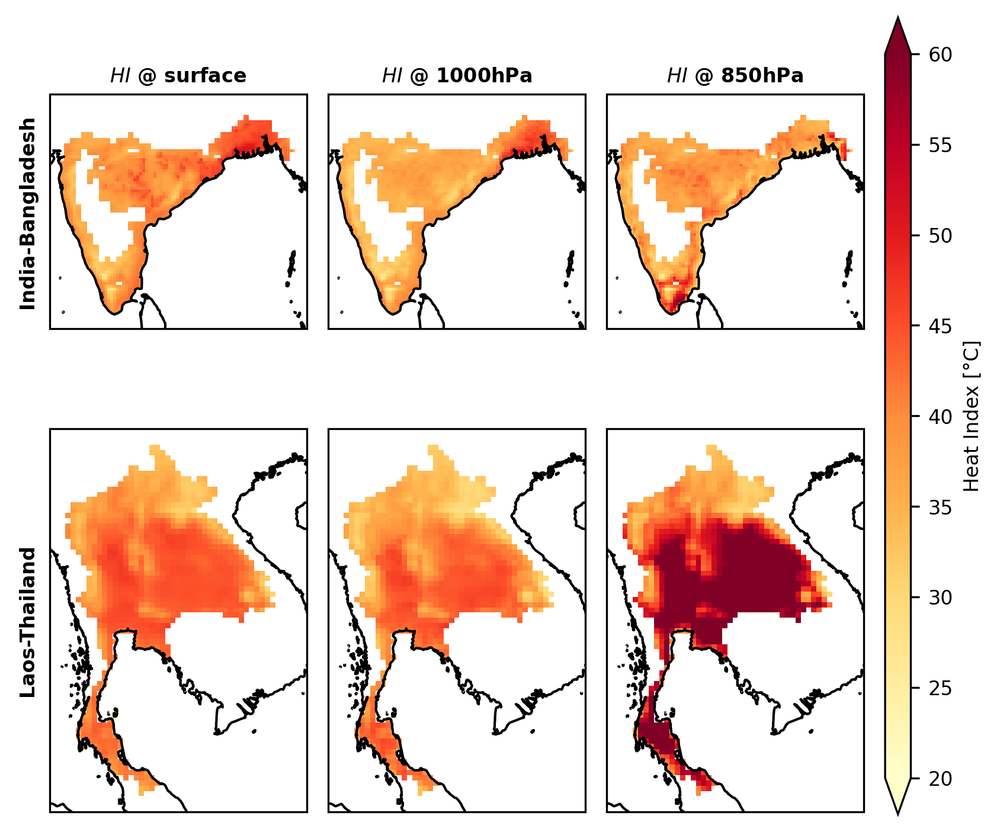

In [25]:
aspect_ratio_single_plot = 0.8

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 2 / 3))

gs = gridspec.GridSpec(
    2,
    4,
    figure=fig,
    width_ratios=[1, 1, 1, 0.1],
)

# heat index danger levels
cmap = matplotlib.colors.ListedColormap(colors)
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

for i, (box, time_slice, mask) in enumerate(zip(boxes, slices, masks, strict=False)):
    for j, l_h in enumerate(labels_humidities):
        ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=-1)
            .sel({"time": time_slice, **box})
        )
        m = clip_data(
            mean_at_time_of_daily_hi_max(
                gt_data["heat_index"]
                .sel({"source": "ERA5", "level": l_h})
                .sel({"time": time_slice, **box}),
                hi_gt=hi_gt,
            ),
            mask=mask,
        ).plot(ax=ax, cmap="YlOrRd", vmax=60, vmin=20, add_colorbar=False)
        ax.coastlines()
        ax.set_title("")

add_headers(
    fig=fig,
    row_headers=labels_countries,
    col_headers=[f"$HI$ @ {humidities_title_labels[l_h]}" for l_h in labels_humidities],
    fontweight="bold",
)

ax_cb = plt.subplot(gs[:, 3])
ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
cbar = plt.colorbar(mappable=m, cax=ax_cb, extend="both", label="Heat Index [°C]")

plt.tight_layout()

plt.savefig("images/2023_humid_heatwave_hi_cutout.png")

Quantities at time of daily min Heat Index:

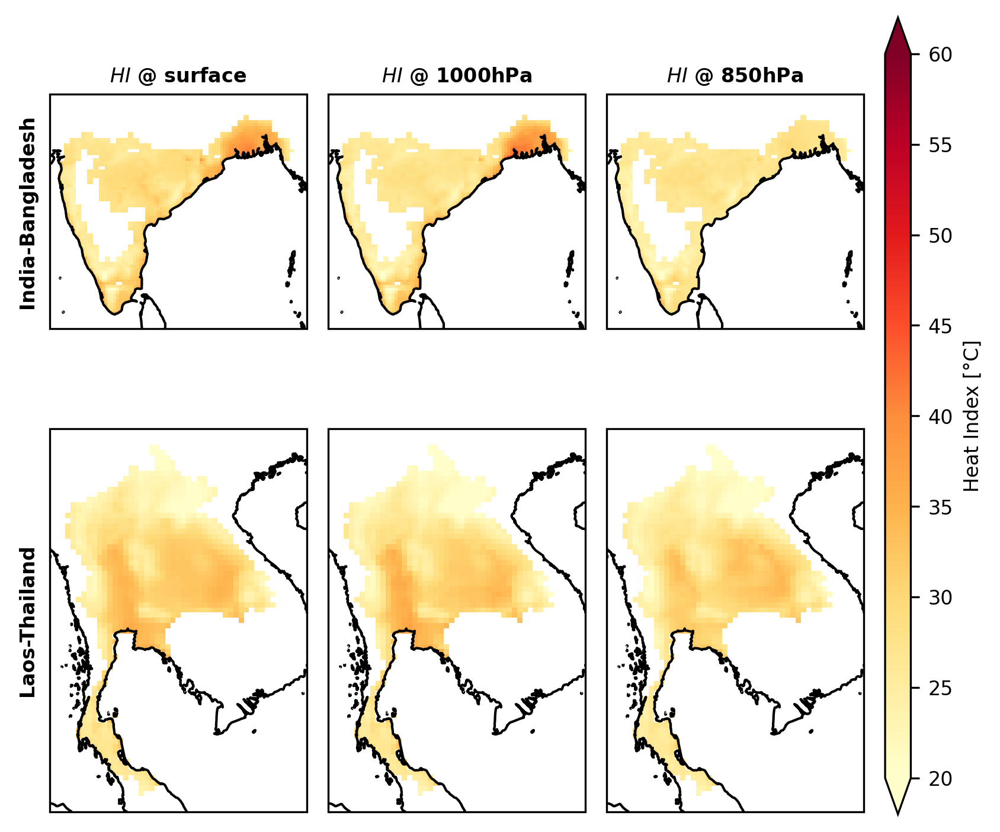

In [26]:
aspect_ratio_single_plot = 0.8

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 2 / 3))

gs = gridspec.GridSpec(
    2,
    4,
    figure=fig,
    width_ratios=[1, 1, 1, 0.1],
)

# heat index danger levels
cmap = matplotlib.colors.ListedColormap(colors)
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

for i, (box, time_slice, mask) in enumerate(zip(boxes, slices, masks, strict=False)):
    for j, l_h in enumerate(labels_humidities):
        ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=-1)
            .sel({"time": time_slice, **box})
        )
        m = clip_data(
            mean_at_time_of_daily_hi_min(
                gt_data["heat_index"]
                .sel({"source": "ERA5", "level": l_h})
                .sel({"time": time_slice, **box}),
                hi_gt=hi_gt,
            ),
            mask=mask,
        ).plot(ax=ax, cmap="YlOrRd", vmax=60, vmin=20, add_colorbar=False)
        ax.coastlines()
        ax.set_title("")

add_headers(
    fig=fig,
    row_headers=labels_countries,
    col_headers=[f"$HI$ @ {humidities_title_labels[l_h]}" for l_h in labels_humidities],
    fontweight="bold",
)

ax_cb = plt.subplot(gs[:, 3])
ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
cbar = plt.colorbar(mappable=m, cax=ax_cb, extend="both", label="Heat Index [°C]")

plt.tight_layout()

plt.savefig("images/2023_humid_heatwave_hi_cutout_min.png")

## Statistics for Area above thresholds.

First step: use the same temporal aggregation as WWA, take a spatial integral.

The weights are normalized so that their mean is one.

In [27]:
# by default the weights get computed in a way that they have mean one (and only contain values over latitudes)
# We also want to assign an area to every grid cell (as a quantity with a unit), therefore we need to rescale the weights.

w = get_lat_weights(grid)
ERA5_Area = rescaled_weights(w, grid.longitude)

thresholds = np.arange(20, 101)

In [28]:
hist_max_same_level = {}
weights = {}
for box, l_c, time_slice, mask in zip(
    boxes, labels_countries, slices, masks, strict=False
):
    hist_max_same_level[l_c] = {}
    hist_max_same_level[l_c]["ERA5"] = {}
    hist_max_same_level[l_c]["HRES_t0"] = {}
    for l_h in labels_humidities:
        # ERA5
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=l_h)
            .sel({"time": time_slice, **box})
        )
        hist_max_same_level[l_c]["ERA5"][l_h] = clip_data(
            mean_at_time_of_daily_hi_max(
                gt_data["heat_index"]
                .sel(source="ERA5", level=l_h)
                .sel({"time": time_slice, **box}),
                hi_gt=hi_gt,
            ),
            mask=mask,
        )

        # HRES-t0
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="HRES_t0", level=l_h)
            .sel({"time": time_slice, **box})
        )
        hist_max_same_level[l_c]["HRES_t0"][l_h] = clip_data(
            mean_at_time_of_daily_hi_max(
                gt_data["heat_index"]
                .sel(source="HRES_t0", level=l_h)
                .sel({"time": time_slice, **box}),
                hi_gt=hi_gt,
            ),
            mask=mask,
        )
    weights[l_c] = clip_data(ERA5_Area.sel(**box), mask)

In [29]:
hist = {}
weights = {}
for box, l_c, time_slice, mask in zip(
    boxes, labels_countries, slices, masks, strict=False
):
    hist[l_c] = {}
    hist[l_c]["ERA5"] = {}
    hist[l_c]["HRES_t0"] = {}
    for l_h in labels_humidities:
        # ERA5
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="ERA5", level=-1)
            .sel({"time": time_slice, **box})
        )
        hist[l_c]["ERA5"][l_h] = clip_data(
            mean_at_time_of_daily_hi_max(
                gt_data["heat_index"]
                .sel(source="ERA5", level=l_h)
                .sel({"time": time_slice, **box}),
                hi_gt=hi_gt,
            ),
            mask=mask,
        )

        # HRES-t0
        hi_gt = (
            gt_data["heat_index"]
            .sel(source="HRES_t0", level=-1)
            .sel({"time": time_slice, **box})
        )
        hist[l_c]["HRES_t0"][l_h] = clip_data(
            mean_at_time_of_daily_hi_max(
                gt_data["heat_index"]
                .sel(source="HRES_t0", level=l_h)
                .sel({"time": time_slice, **box}),
                hi_gt=hi_gt,
            ),
            mask=mask,
        )
    weights[l_c] = clip_data(ERA5_Area.sel(**box), mask)

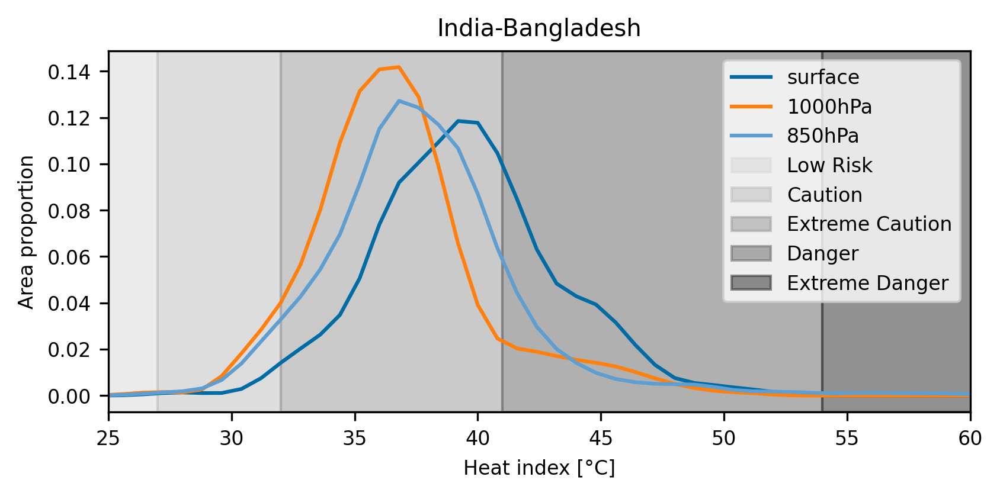

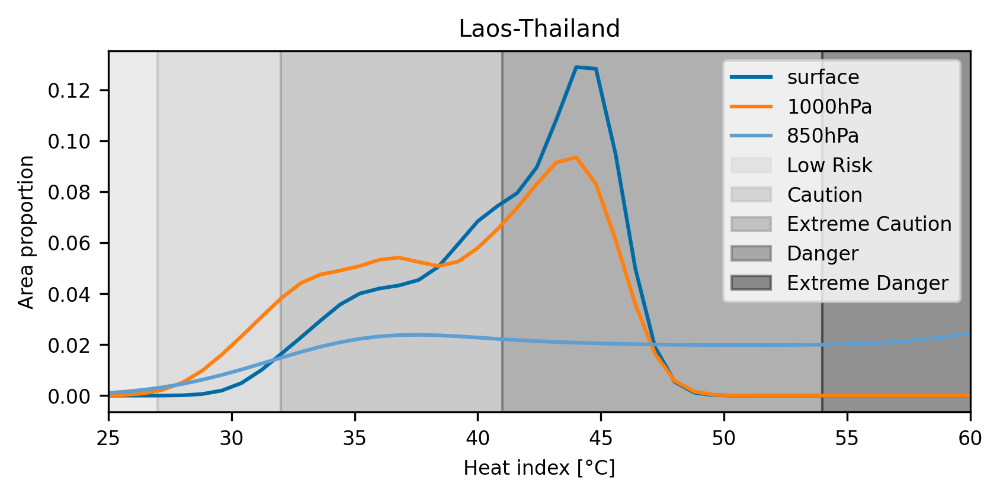

In [30]:
aspect_ratio_single_plot = 2

for l_c in labels_countries:
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches(textwidth, textwidth / aspect_ratio_single_plot)
    thres = np.linspace(np.amin(thresholds), np.amax(thresholds), 101)

    for l_h in labels_humidities:
        data = hist[l_c]["ERA5"][l_h].to_numpy().flatten()
        w = weights[l_c].to_numpy().flatten()
        kde = stats.gaussian_kde(
            data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
        )
        density = kde.evaluate(thres)
        ax.plot(thres, density, label=f"{humidities_title_labels[l_h]}")
    ax.set_ylabel("Area proportion")
    ax.set_xlabel("Heat index [°C]")
    ax.set_title(f"{l_c}")
    ax.set_xlim(25, 60)

    ax.axvspan(
        thresholds[0], inner_bounds[0], alpha=0.5, color=colors[0], label=labels[0]
    )
    ax.axvspan(
        inner_bounds[0], inner_bounds[1], alpha=0.5, color=colors[1], label=labels[1]
    )
    ax.axvspan(
        inner_bounds[1], inner_bounds[2], alpha=0.5, color=colors[2], label=labels[2]
    )
    ax.axvspan(
        inner_bounds[2], inner_bounds[3], alpha=0.5, color=colors[3], label=labels[3]
    )
    ax.axvspan(
        inner_bounds[3], thresholds[-1], alpha=0.5, color=colors[4], label=labels[4]
    )

    ax.legend()

    plt.tight_layout()
    plt.savefig(f"images/2023_humid_heatwave_area_statistics_varying_sources_{l_c}.png")

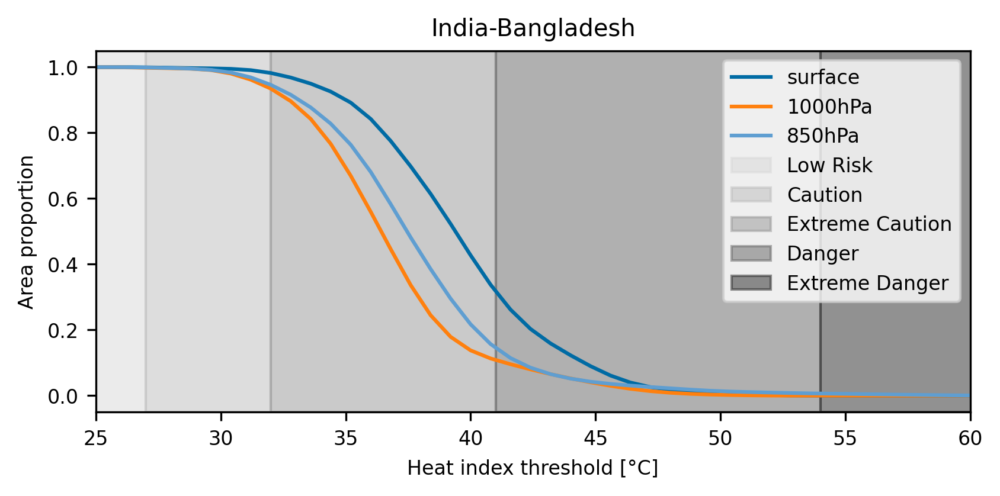

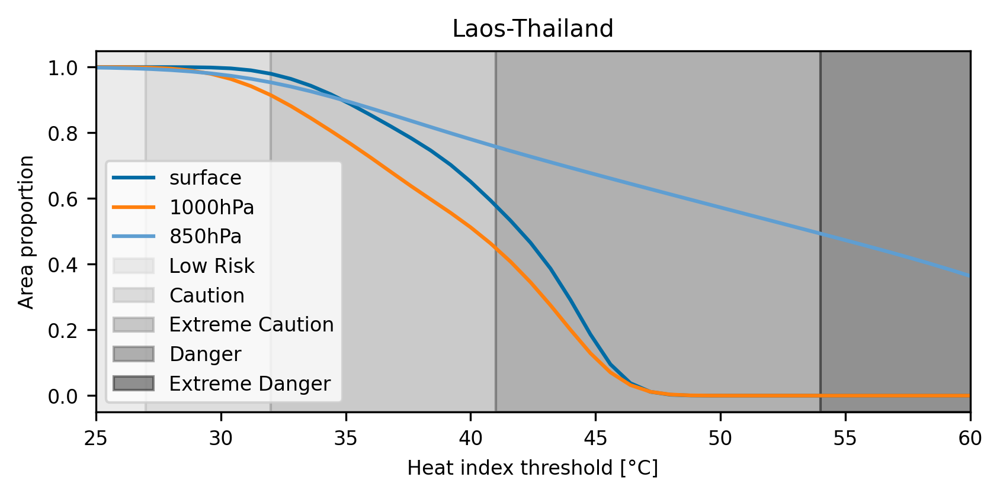

In [31]:
for l_c in labels_countries:
    aspect_ratio_single_plot = 2

    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches(textwidth, textwidth * 1 / aspect_ratio_single_plot)

    thres = np.linspace(np.amin(thresholds), np.amax(thresholds), 101)

    for l_h in labels_humidities:
        data = hist[l_c]["ERA5"][l_h].to_numpy().flatten()
        w = weights[l_c].to_numpy().flatten()
        kde = stats.gaussian_kde(
            data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
        )
        cdf = np.array([1 - kde.integrate_box_1d(-np.inf, t) for t in thres])
        ax.plot(thres, cdf, label=f"{humidities_title_labels[l_h]}")
    ax.set_ylabel("Area proportion")
    ax.set_xlabel("Heat index threshold [°C]")
    ax.set_title(f"{l_c}")
    ax.set_xlim(25, 60)

    ax.axvspan(
        thresholds[0], inner_bounds[0], alpha=0.5, color=colors[0], label=labels[0]
    )
    ax.axvspan(
        inner_bounds[0], inner_bounds[1], alpha=0.5, color=colors[1], label=labels[1]
    )
    ax.axvspan(
        inner_bounds[1], inner_bounds[2], alpha=0.5, color=colors[2], label=labels[2]
    )
    ax.axvspan(
        inner_bounds[2], inner_bounds[3], alpha=0.5, color=colors[3], label=labels[3]
    )
    ax.axvspan(
        inner_bounds[3], thresholds[-1], alpha=0.5, color=colors[4], label=labels[4]
    )
    ax.legend()

    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_area_statistics_varying_sources_cum_{l_c}.png"
    )

## Heat index for forecasts.

Start by doing some quality tests on ground truth data sets. This will be continued towards the end of the notebook.

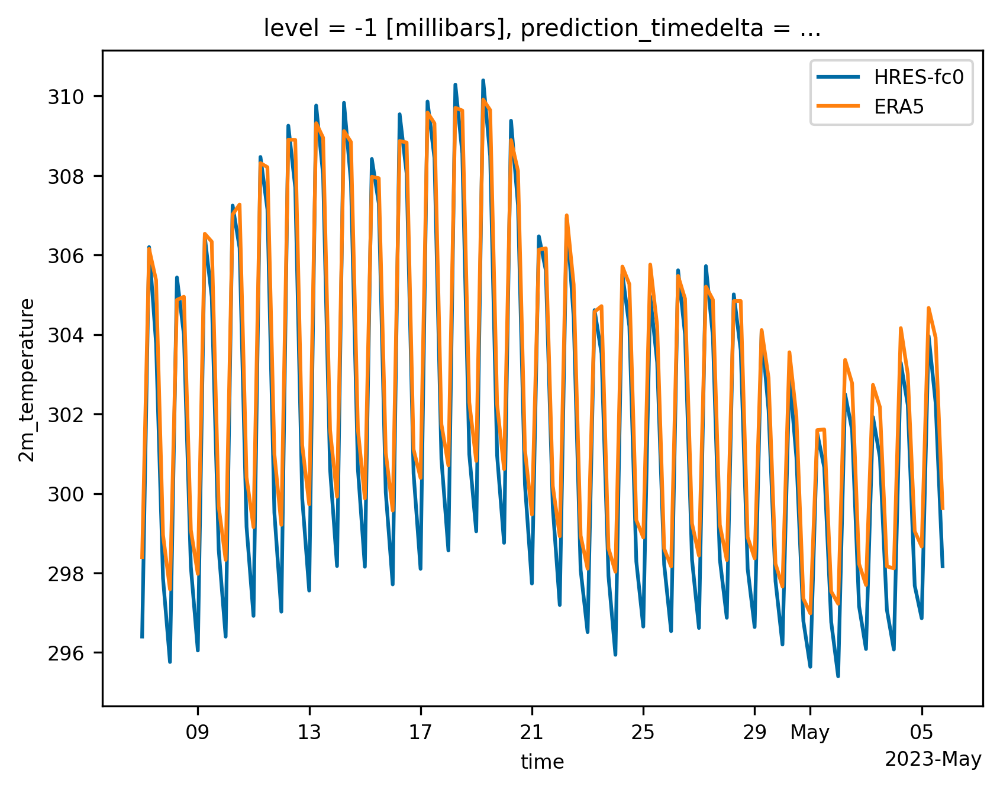

In [32]:
# 2m temperatures:
clip_data(
    gt_data.sel(source="HRES_t0", level=-1)["2m_temperature"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="HRES-fc0")
clip_data(gt_data.sel(source="ERA5", level=-1)["2m_temperature"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="ERA5")
plt.legend()

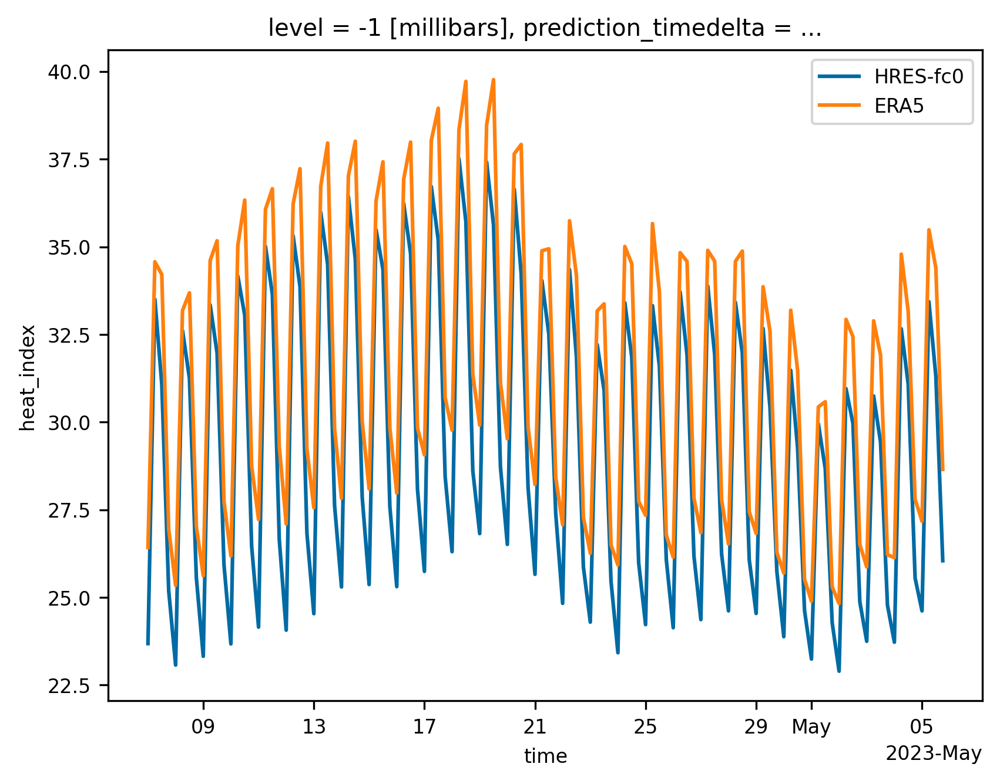

In [33]:
# heat index:

clip_data(gt_data.sel(source="HRES_t0", level=-1)["heat_index"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="HRES-fc0")
clip_data(gt_data.sel(source="ERA5", level=-1)["heat_index"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="ERA5")
plt.legend()

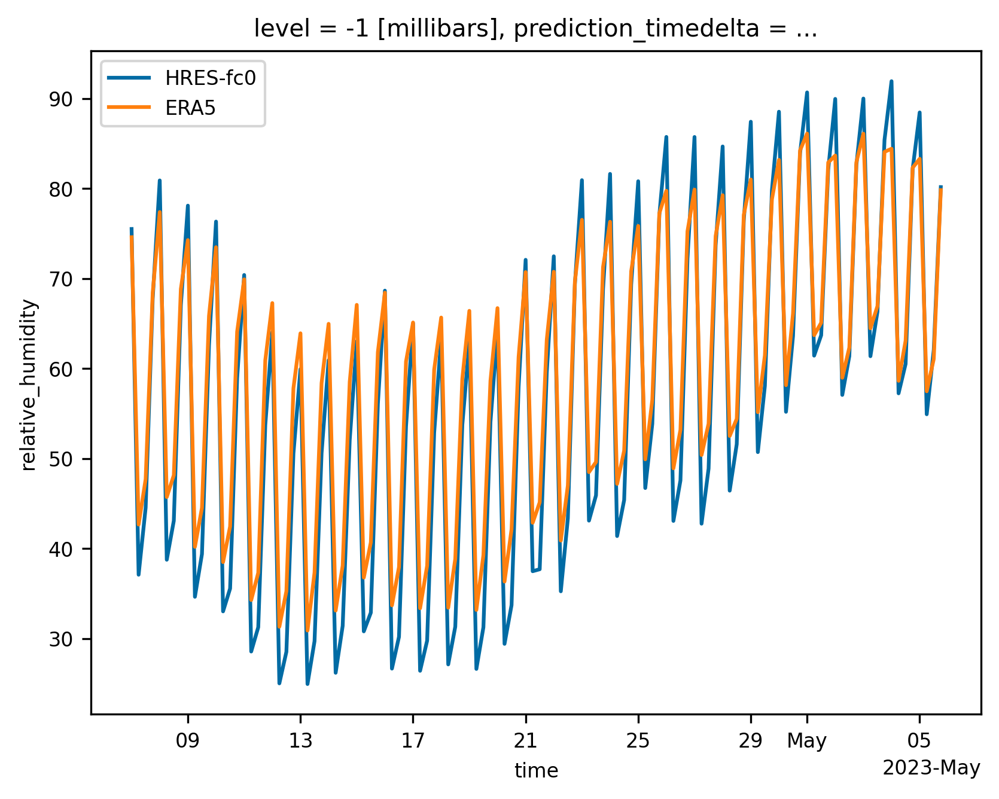

In [34]:
# relative humidity

clip_data(
    gt_data.sel(source="HRES_t0", level=-1)["relative_humidity"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="HRES-fc0")
clip_data(
    gt_data.sel(source="ERA5", level=-1)["relative_humidity"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="ERA5")
plt.legend()

Then, estimate densities:

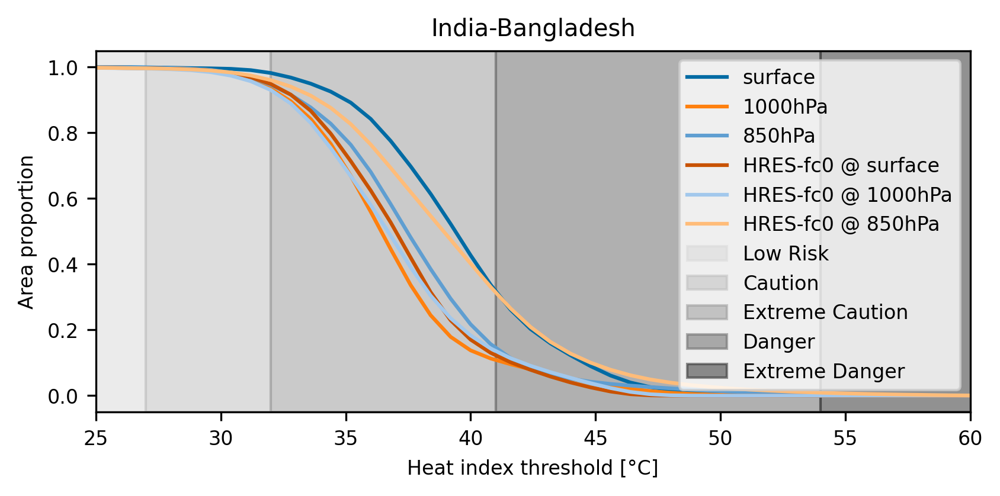

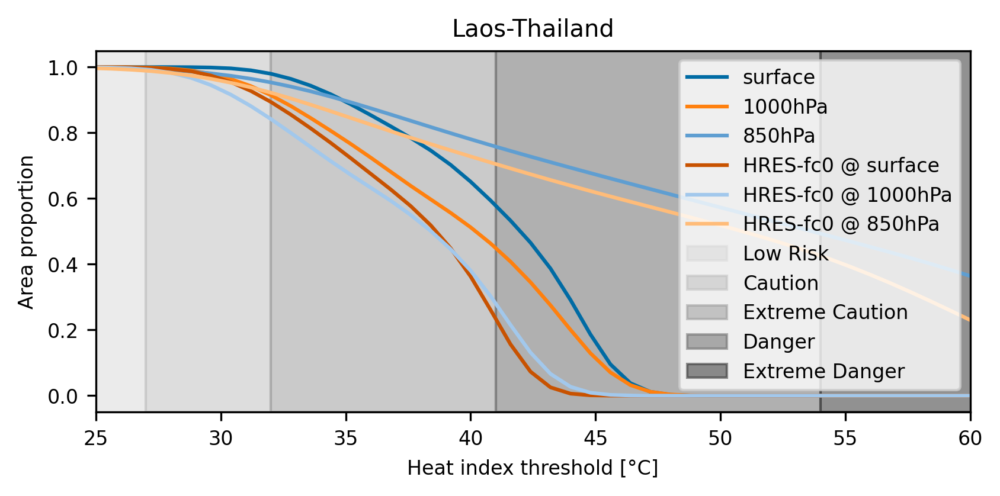

In [35]:
# cumulative:
for l_c in labels_countries:
    aspect_ratio_single_plot = 2

    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches(textwidth, textwidth * 1 / aspect_ratio_single_plot)

    thres = np.linspace(np.amin(thresholds), np.amax(thresholds), 101)

    for l_h in labels_humidities:
        data = hist[l_c]["ERA5"][l_h].to_numpy().flatten()
        w = weights[l_c].to_numpy().flatten()
        kde = stats.gaussian_kde(
            data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
        )
        cdf = np.array([1 - kde.integrate_box_1d(-np.inf, t) for t in thres])
        ax.plot(thres, cdf, label=f"{humidities_title_labels[l_h]}")
    # HRES
    for l_h in labels_humidities:
        data = hist[l_c]["HRES_t0"][l_h].to_numpy().flatten()
        w = weights[l_c].to_numpy().flatten()
        kde = stats.gaussian_kde(
            data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
        )
        cdf = np.array([1 - kde.integrate_box_1d(-np.inf, t) for t in thres])
        ax.plot(thres, cdf, label=f"HRES-fc0 @ {humidities_title_labels[l_h]}")
    ax.set_ylabel("Area proportion")
    ax.set_xlabel("Heat index threshold [°C]")
    ax.set_title(f"{l_c}")
    ax.set_xlim(25, 60)

    ax.axvspan(
        thresholds[0], inner_bounds[0], alpha=0.5, color=colors[0], label=labels[0]
    )
    ax.axvspan(
        inner_bounds[0], inner_bounds[1], alpha=0.5, color=colors[1], label=labels[1]
    )
    ax.axvspan(
        inner_bounds[1], inner_bounds[2], alpha=0.5, color=colors[2], label=labels[2]
    )
    ax.axvspan(
        inner_bounds[2], inner_bounds[3], alpha=0.5, color=colors[3], label=labels[3]
    )
    ax.axvspan(
        inner_bounds[3], thresholds[-1], alpha=0.5, color=colors[4], label=labels[4]
    )
    ax.legend()

    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_area_statistics_varying_sources_cum_{l_c}.png"
    )

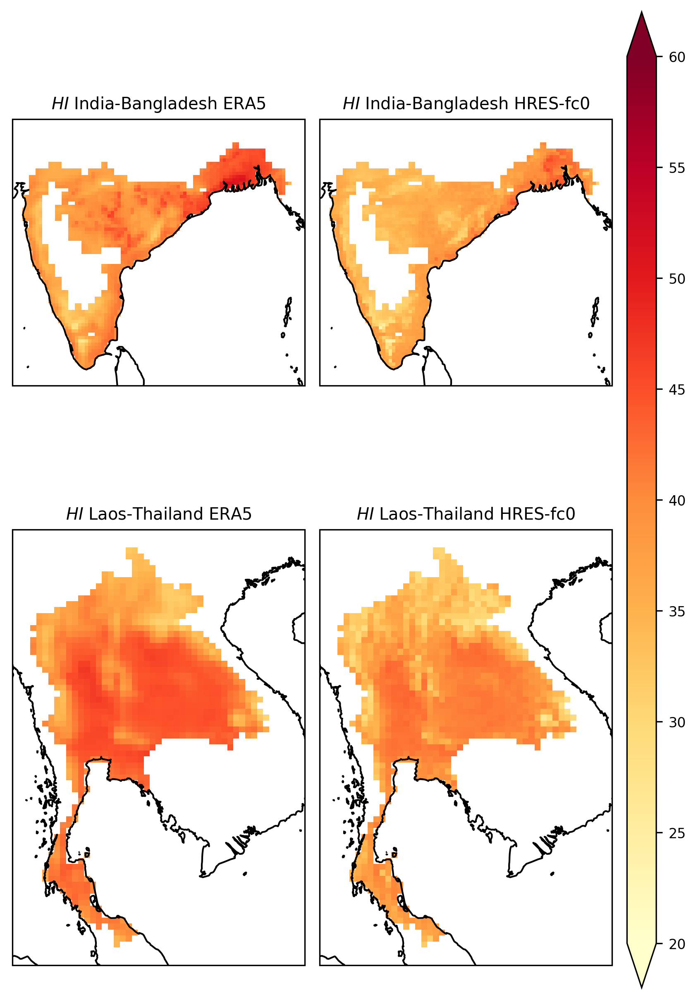

In [36]:
aspect_ratio_single_plot = 0.7

fig = plt.figure(figsize=(textwidth, textwidth / aspect_ratio_single_plot * 2 / 2))

gs = gridspec.GridSpec(
    2,
    3,
    figure=fig,
    width_ratios=[1, 1, 0.1],
)

for i, (box, time_slice, mask) in enumerate(zip(boxes, slices, masks, strict=False)):
    ax = fig.add_subplot(gs[i, 0], projection=ccrs.PlateCarree())
    hi_gt = (
        gt_data["heat_index"]
        .sel(source="ERA5", level=-1)
        .sel({"time": time_slice, **box})
    )
    m = clip_data(
        mean_at_time_of_daily_hi_max(
            gt_data["heat_index"]
            .sel({"source": "ERA5", "level": -1})
            .sel({"time": time_slice, **box}),
            hi_gt=hi_gt,
        ),
        mask=mask,
    ).plot(ax=ax, cmap="YlOrRd", vmax=60, vmin=20, add_colorbar=False)
    ax.coastlines()
    ax.set_title(f"$HI$ {labels_countries[i]} ERA5")

    ax = fig.add_subplot(gs[i, 1], projection=ccrs.PlateCarree())
    hi_gt = (
        gt_data["heat_index"]
        .sel(source="ERA5", level=-1)
        .sel({"time": time_slice, **box})
    )
    m = clip_data(
        mean_at_time_of_daily_hi_max(
            gt_data["heat_index"]
            .sel({"source": "HRES_t0", "level": -1})
            .sel({"time": time_slice, **box}),
            hi_gt=hi_gt,
        ),
        mask=mask,
    ).plot(ax=ax, cmap="YlOrRd", vmax=60, vmin=20, add_colorbar=False)
    ax.coastlines()
    ax.set_title(f"$HI$ {labels_countries[i]} HRES-fc0")

ax_cb = plt.subplot(gs[:, 2])
ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
cbar = plt.colorbar(mappable=m, cax=ax_cb, extend="both")

plt.tight_layout()
plt.savefig("images/2023_humid_heatwave_hres_t0_map.png")

### extract valid samples from forecast data set.

In [37]:
def get_forecast(
    fc: xr.DataArray, ts_event: slice, start_date: np.datetime64
) -> xr.DataArray:
    """Extract the data relevant for an event from the forecast dataset

    Args:
        fc (xr.DataArray): Forecast dataset
        ts_event (slice): Time slice of the event to be investigated
        start_date (np.datetime64): Initialization date of a forecast.

    Returns:
        xr.DataArray: Extracted forecast data.

    """
    res = fc.sel(
        {
            "time": start_date,
            "prediction_timedelta": slice(
                ts_event.start - start_date, ts_event.stop - start_date
            ),
        }
    )
    return (
        res.assign_coords(
            {"prediction_timedelta": start_date + res.prediction_timedelta}
        )
        .drop("time")
        .rename({"prediction_timedelta": "time"})
    )

In [38]:
def extract_list_of_valid_forecasts(
    data: xr.Dataset, slice_time: slice, step_dim_name: str = "step"
):
    """Given an xarray dataset containing the dimensions 'time' and 'step' (alternative names possible), extract the individual forecasts and time steps for which they return valid results.

    Args:
    ----
        data (xr.Dataset): An xarray dataset containing the dimensions 'time' and 'step'. It is assumed that at least one of the forecast covers the entire slice.
        slice_time (slice): Slice specifying begin and end of the event.
        step_dim_name (str): Alternative name for the dimension of the prediction step. Defaults to 'step'.

    Returns:
    -------
        List[xr.Dataset]: A list of datasets, each of which contains only the valid timesteps

    """
    trajectories = []
    for t in data.time:
        valid_steps = data[f"{step_dim_name}"].where(
            ((t + data[f"{step_dim_name}"]) >= slice_time.start)
            & ((t + data[f"{step_dim_name}"]) < slice_time.stop),
            drop=True,
        )
        trajectories.append(data.sel({"time": t, f"{step_dim_name}": valid_steps}))

    len_trajectories = [len(tr[f"{step_dim_name}"]) for tr in trajectories]

    return [
        tr.assign_coords(
            {"valid_time": tr[f"{step_dim_name}"] + tr.time, "init_time": tr.time}
        )
        for tr in trajectories
        if len(tr[f"{step_dim_name}"]) == np.amax(len_trajectories)
    ]

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

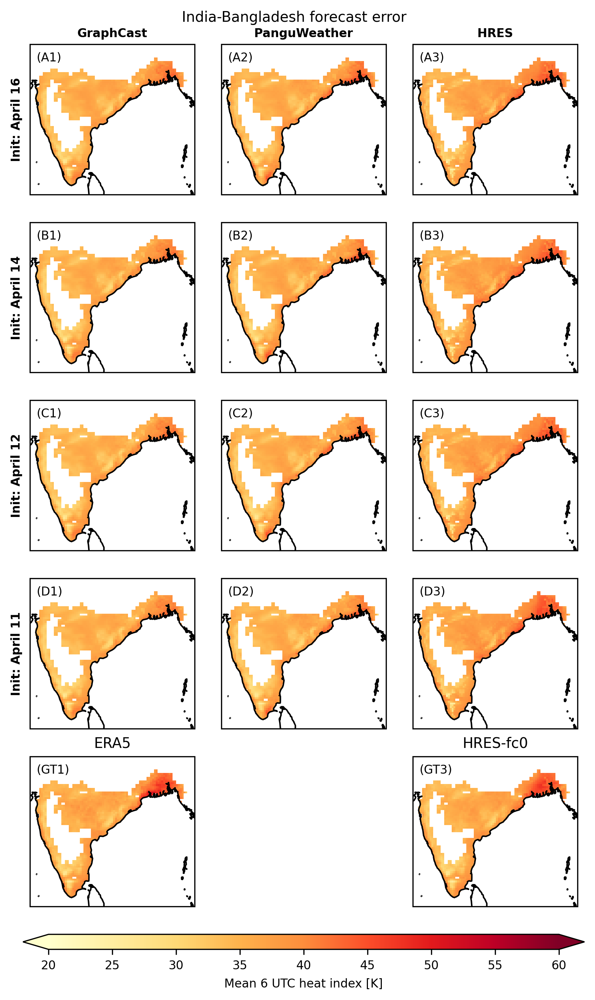

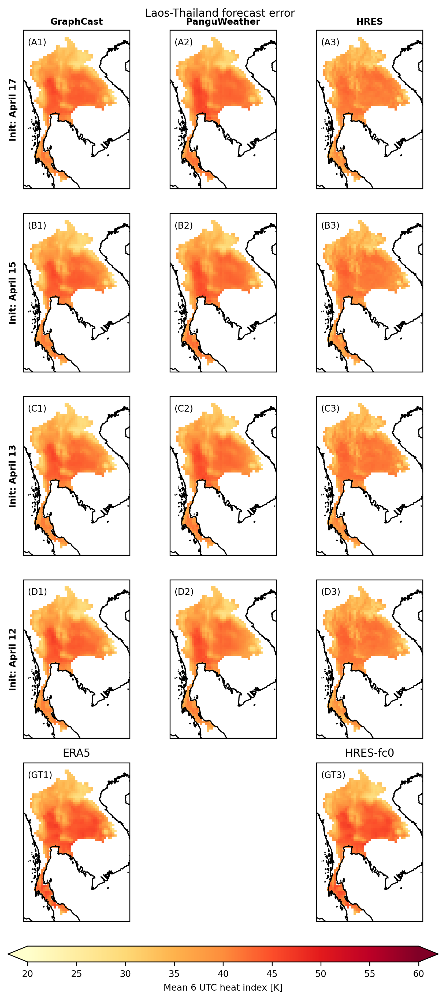

In [39]:
# in this plot (not used in paper, we use HI at the surface to determine the timing of maximum heat index.)
lts = np.array([1, 3, 5, 6])
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = 20
vmax = 60
aspect_ratios_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts) + 1) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 2, 3, figure=fig, height_ratios=(len(lts) + 1) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, lv_name) in enumerate(
            zip(fc_names, level_names, strict=False)
        ):
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_names[j], level=-1)
                .sel({"time": t_slice, **box})
            )
            res = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            res = clip_data(mean_at_time_of_daily_hi_max(res, hi_gt=hi_gt), mask=mask)

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, cmap="YlOrRd", vmax=vmax, vmin=vmin, add_colorbar=False)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")
            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    hi_gt = (
        gt_data["heat_index"].sel(source="ERA5", level=-1).sel({"time": t_slice, **box})
    )

    res_era = (
        gt_data["heat_index"]
        .sel(source="ERA5", level=1000)
        .sel({"time": t_slice, **box})
    )
    res_era = clip_data(mean_at_time_of_daily_hi_max(res_era, hi_gt=hi_gt), mask=mask)

    ax_era = fig.add_subplot(gs[-2, 0], projection=ccrs.PlateCarree())

    m = res_era.plot(ax=ax_era, cmap="YlOrRd", vmax=vmax, vmin=vmin, add_colorbar=False)

    ax_era.coastlines()
    ax_era.set_title("ERA5")

    hi_gt = (
        gt_data["heat_index"]
        .sel(source="HRES_t0", level=-1)
        .sel({"time": t_slice, **box})
    )

    res_hres_t0 = (
        gt_data["heat_index"]
        .sel(source="ERA5", level=1000)
        .sel({"time": t_slice, **box})
    )
    res_hres_t0 = clip_data(
        mean_at_time_of_daily_hi_max(res_hres_t0, hi_gt=hi_gt), mask=mask
    )

    ax_hres_t0 = fig.add_subplot(gs[-2, 2], projection=ccrs.PlateCarree())

    m = res_hres_t0.plot(
        ax=ax_hres_t0, cmap="YlOrRd", vmax=vmax, vmin=vmin, add_colorbar=False
    )

    ax_hres_t0.coastlines()
    ax_hres_t0.set_title("HRES-fc0")

    add_label_to_axes(ax_era, "(GT1)")
    add_label_to_axes(ax_hres_t0, "(GT3)")

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label="Mean 6 UTC heat index [K]",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()

    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_{country_label}.png"
    )

### forecast error

Computing everything at 1000hPa.

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

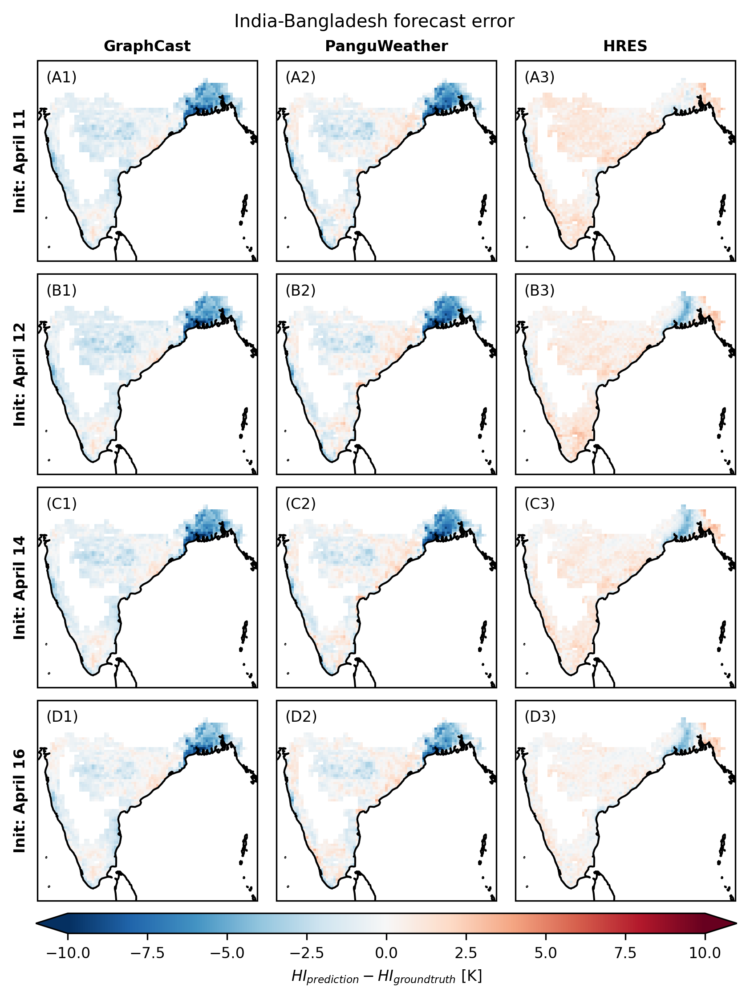

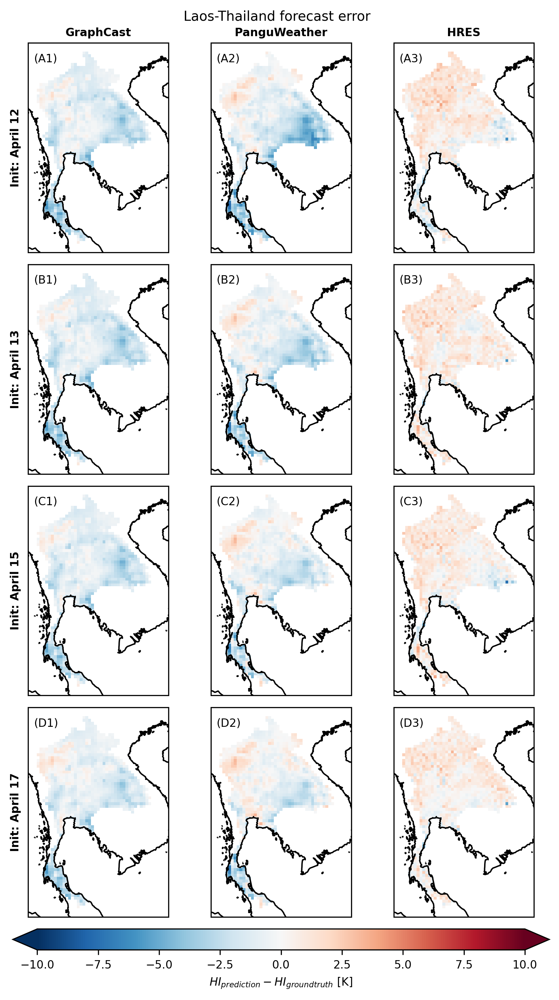

In [40]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, 1000]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = -10
vmax = 10
aspect_ratios_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 1, 3, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["heat_index"]
                .sel(
                    source=gt_name, level=1000
                )  # -1 if respect to timing of surface maximum
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="RdBu_r", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$HI_{prediction} - HI_{ground truth}$ [K]",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_all_1000hPa_{country_label}.png"
    )

HI category:

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

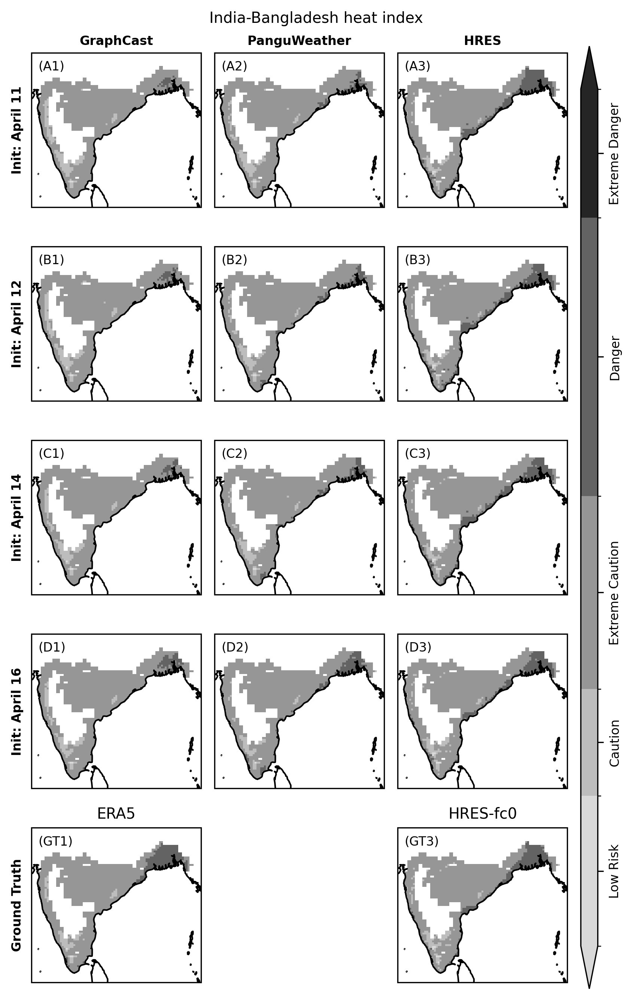

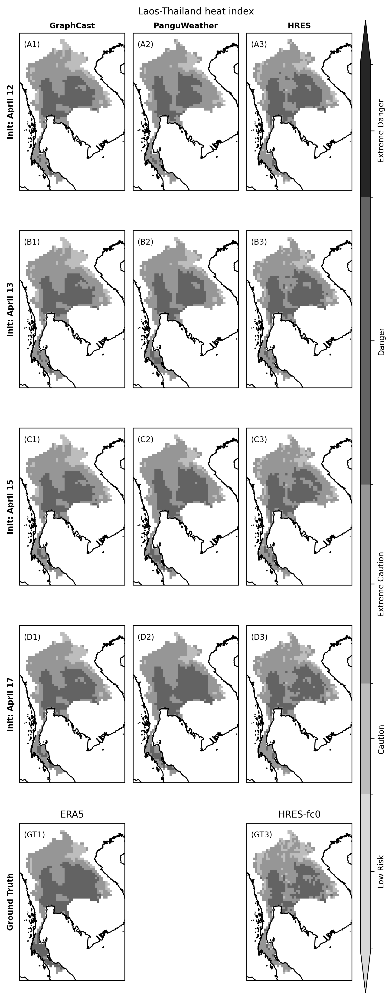

In [41]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, 1000]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]
aspect_ratios_single_plot = [1.05, 0.65]


# heat index danger levels
cmap = matplotlib.colors.ListedColormap(colors)
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts) + 1) / 3))
    gs = gridspec.GridSpec(len(lts) + 1, 4, figure=fig, width_ratios=[1, 1, 1, 0.1])

    ax_era5 = fig.add_subplot(gs[-1, 0], projection=ccrs.PlateCarree())
    ax_hres_t0 = fig.add_subplot(gs[-1, 2], projection=ccrs.PlateCarree())

    hi_gt = (
        gt_data["heat_index"].sel(source="ERA5", level=1000).sel(box).sel(time=t_slice)
    )

    clip_data(
        mean_at_time_of_daily_hi_max(
            gt_data["heat_index"]
            .sel(source="ERA5", level=1000)
            .sel(**box, time=t_slice),
            hi_gt=hi_gt,
        ),
        mask=mask,
    ).plot(ax=ax_era5, add_colorbar=False, cmap=cmap, norm=norm)

    hi_gt = (
        gt_data["heat_index"]
        .sel(source="HRES_t0", level=1000)
        .sel(box)
        .sel(time=t_slice)
    )

    clip_data(
        mean_at_time_of_daily_hi_max(
            gt_data["heat_index"]
            .sel(source="HRES_t0", level=1000)
            .sel(**box, time=t_slice),
            hi_gt=hi_gt,
        ),
        mask=mask,
    ).plot(ax=ax_hres_t0, add_colorbar=False, cmap=cmap, norm=norm)

    ax_era5.coastlines()
    ax_era5.set_title("ERA5")

    ax_hres_t0.coastlines()
    ax_hres_t0.set_title("HRES-fc0")

    add_label_to_axes(ax_era5, "(GT1)")
    add_label_to_axes(ax_hres_t0, "(GT3)")

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, lv_name, gt_name) in enumerate(
            zip(fc_names, level_names, gt_names, strict=False)
        ):
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=1000)
                .sel(box)
                .sel(time=t_slice)
            )

            res = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            res = clip_data(mean_at_time_of_daily_hi_max(res, hi_gt=hi_gt), mask=mask)

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap=cmap, norm=norm)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")
            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ]
        + ["Ground Truth"],
        fontweight="bold",
    )

    ax_cb = plt.subplot(gs[:, -1])
    ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
    fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
    cbar = plt.colorbar(
        mappable=m,
        cax=ax_cb,
        format=fmt,
        ticks=ticks,
        extend="both",
        spacing="proportional",
    )
    cbar.ax.tick_params(axis="y", labelrotation=90)
    cbar.ax.set_yticklabels(cbar.ax.get_yticklabels(), verticalalignment="center")

    fig.suptitle(country_label + " heat index")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_heat_index_map_all_1000hPa_{country_label}.png"
    )

2m temperature:

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

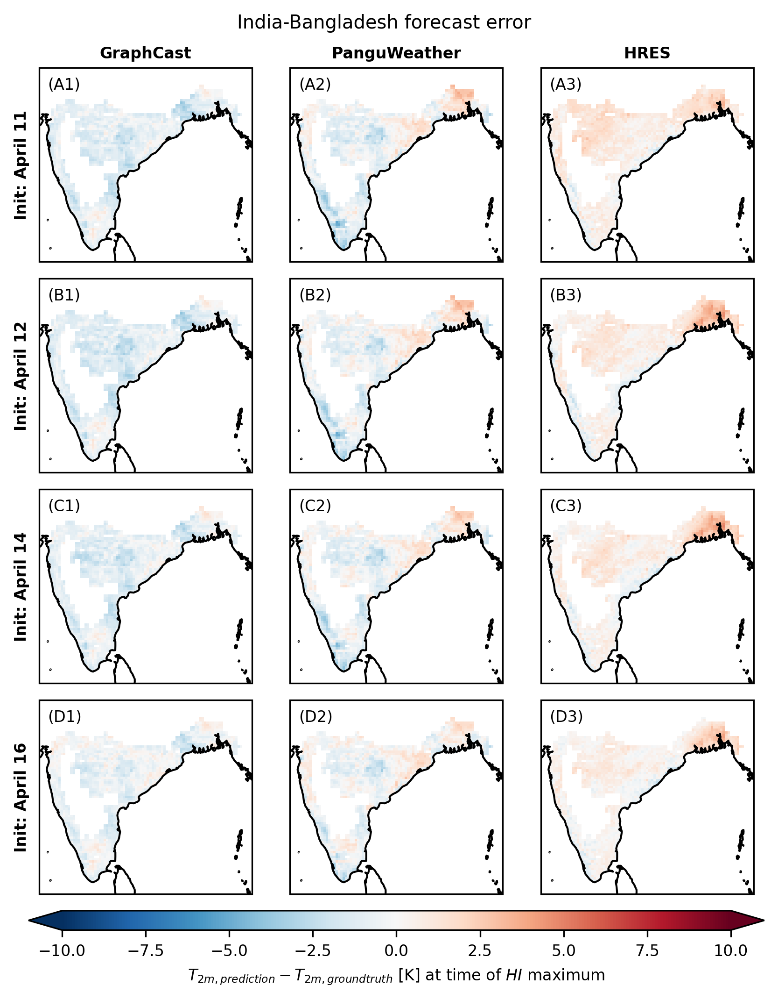

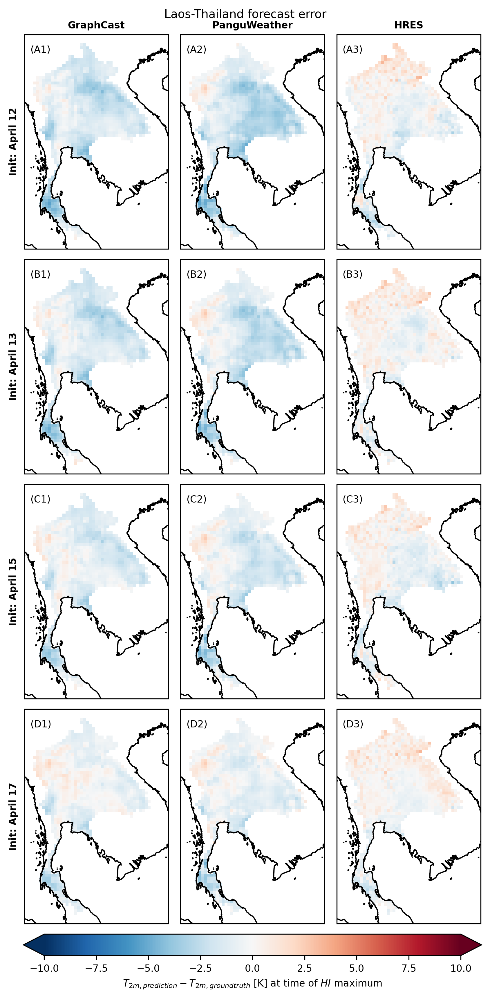

In [42]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = -10
vmax = 10
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 1, 3, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name) in enumerate(zip(fc_names, gt_names, strict=False)):
            fc = get_forecast(
                fc=fc_data["2m_temperature"].sel(forecast=fc_name, level=-1).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["2m_temperature"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=1000)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="RdBu_r", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$T_{2m, prediction} - T_{2m, ground truth}$ [K] at time of $HI$ maximum",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_only_1000hPa_temperature_{country_label}.png"
    )

Humidity:

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

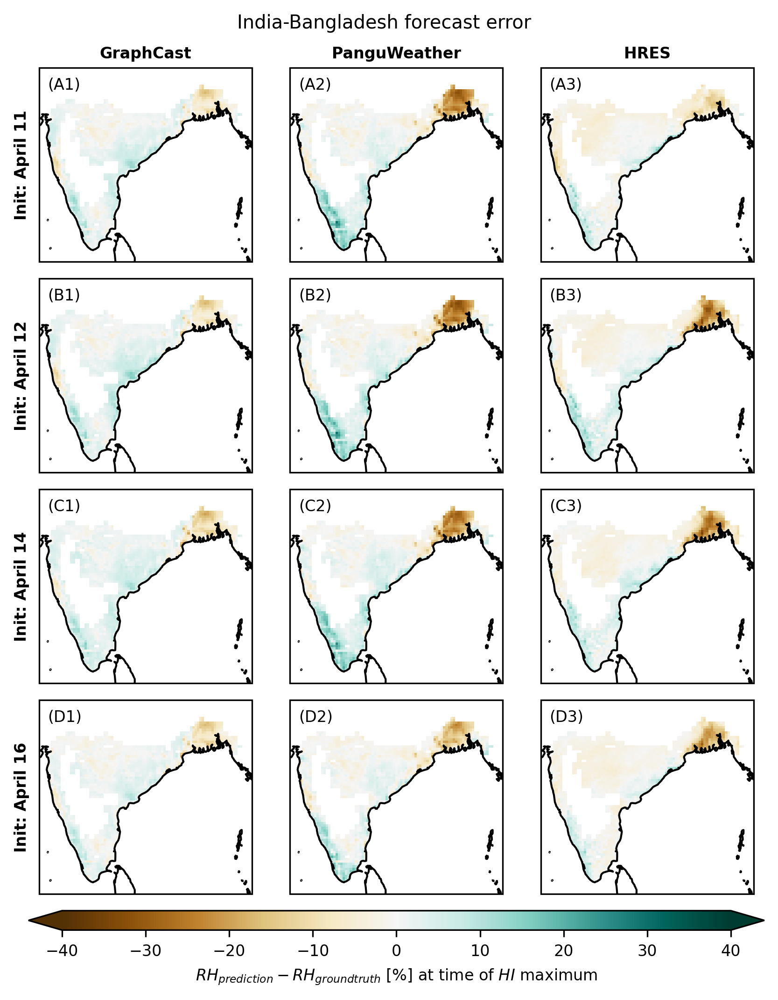

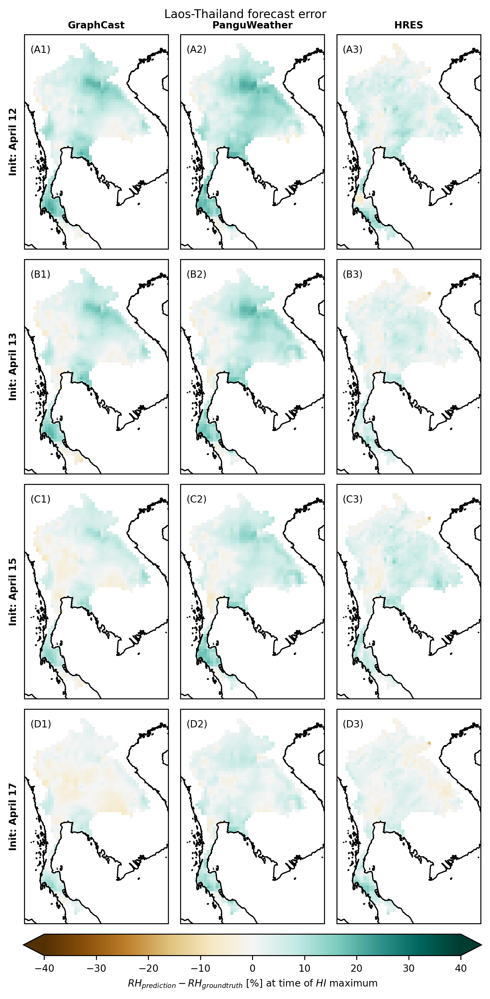

In [43]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, 1000]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = -40
vmax = 40
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 1, 3, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["relative_humidity"]
                .sel(forecast=fc_name, level=lv_name)
                .sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["relative_humidity"]
                .sel(source=gt_name, level=1000)  # -1 if wrt surface
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=1000)  # -1 if wrt surface
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="BrBG", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")
            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$RH_{prediction} - RH_{ground truth}$ [%] at time of $HI$ maximum",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_only_1000hPa_humidity_{country_label}.png"
    )

## older plots

In earlier experiments, we used the heat index at the surface as a baseline to compute the forecast errors. This however is quite susceptible to existing differences in the ground truth data sets.

First, heat index:

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

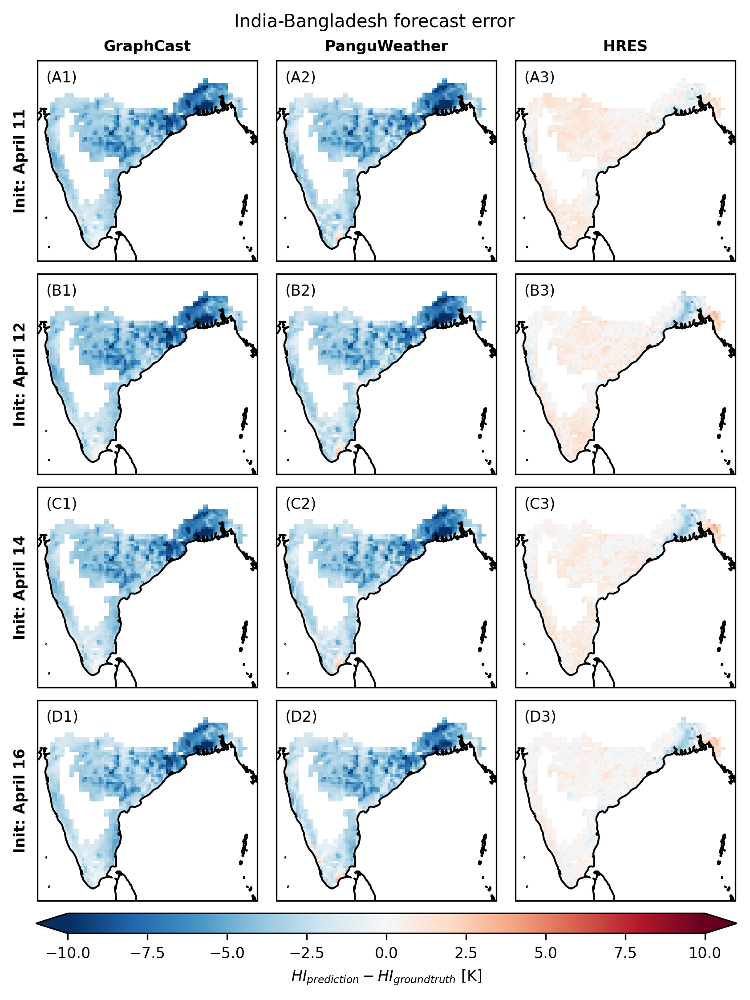

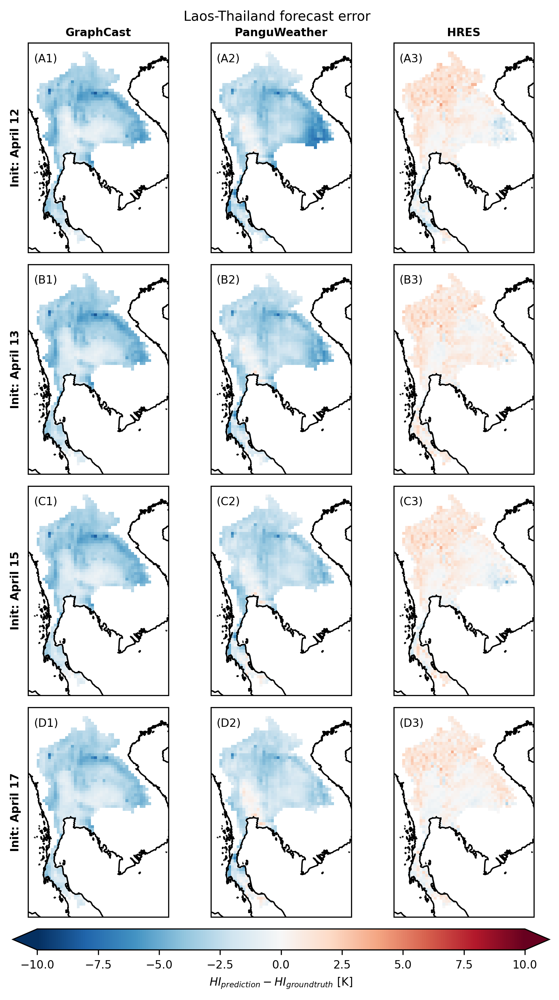

In [44]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = -10
vmax = 10
aspect_ratios_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 1, 3, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="RdBu_r", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$HI_{prediction} - HI_{ground truth}$ [K]",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_surface_{country_label}.png"
    )

Heat index, including additional column with additional forecast version - using HRES forecasts both at "surface" heat index, and heat index computed using humidity at 1000hPa

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

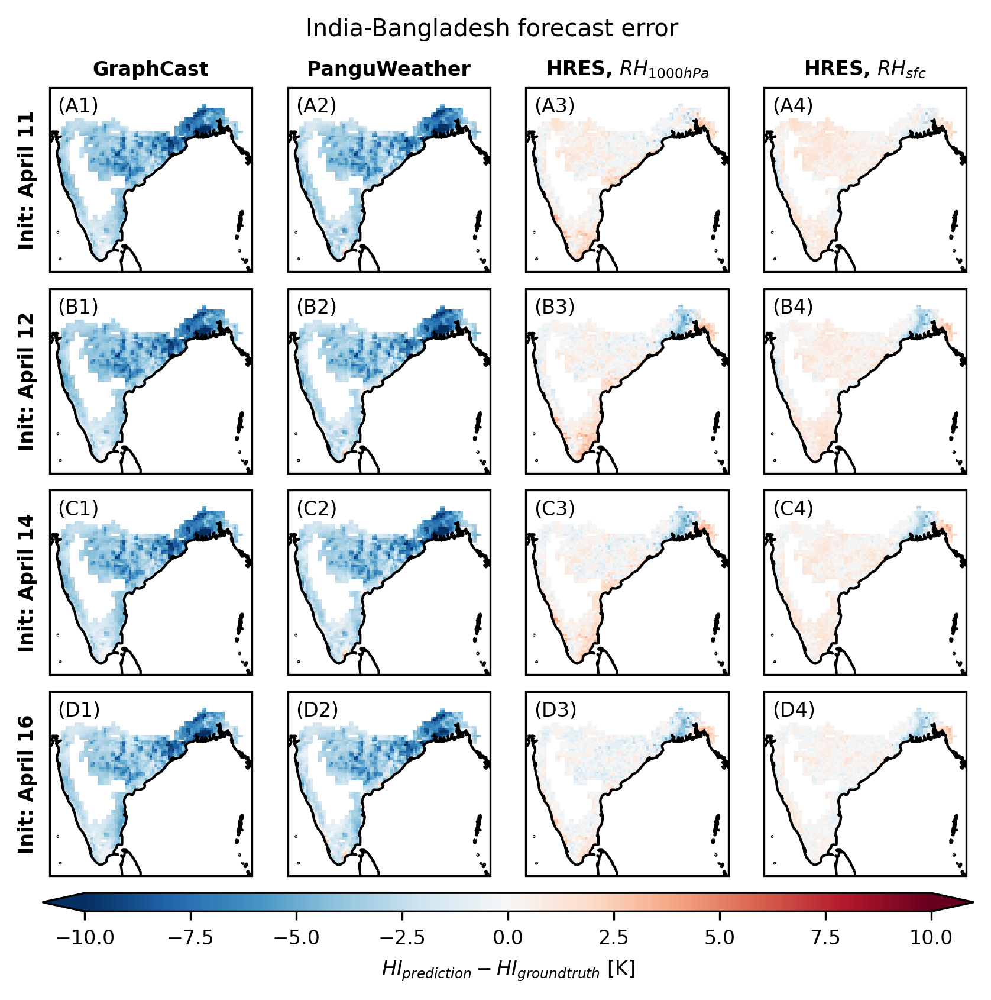

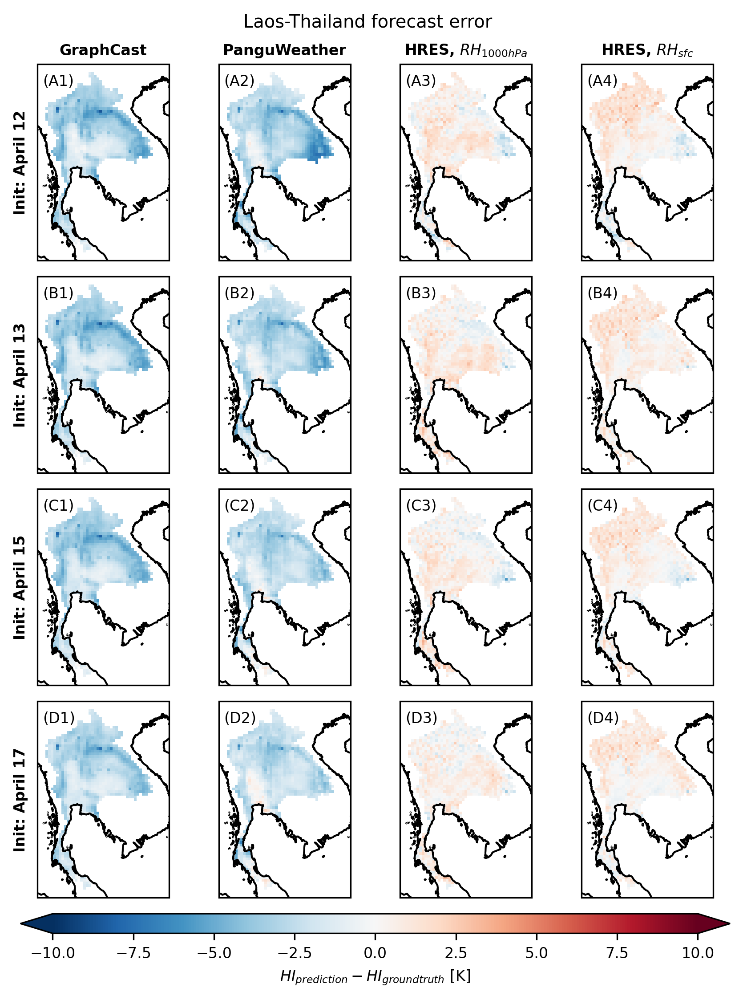

In [45]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES", "HRES"]
level_names = [1000, 1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]
vmin = -10
vmax = 10
aspect_ratios_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 4))
    gs = gridspec.GridSpec(
        len(lts) + 1, 4, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="RdBu_r", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=[
            "GraphCast",
            "PanguWeather",
            "HRES, $RH_{1000hPa}$",
            "HRES, $RH_{sfc}$",
        ],
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$HI_{prediction} - HI_{ground truth}$ [K]",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_surface_hres_versions_{country_label}.png"
    )

same for temperature.

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

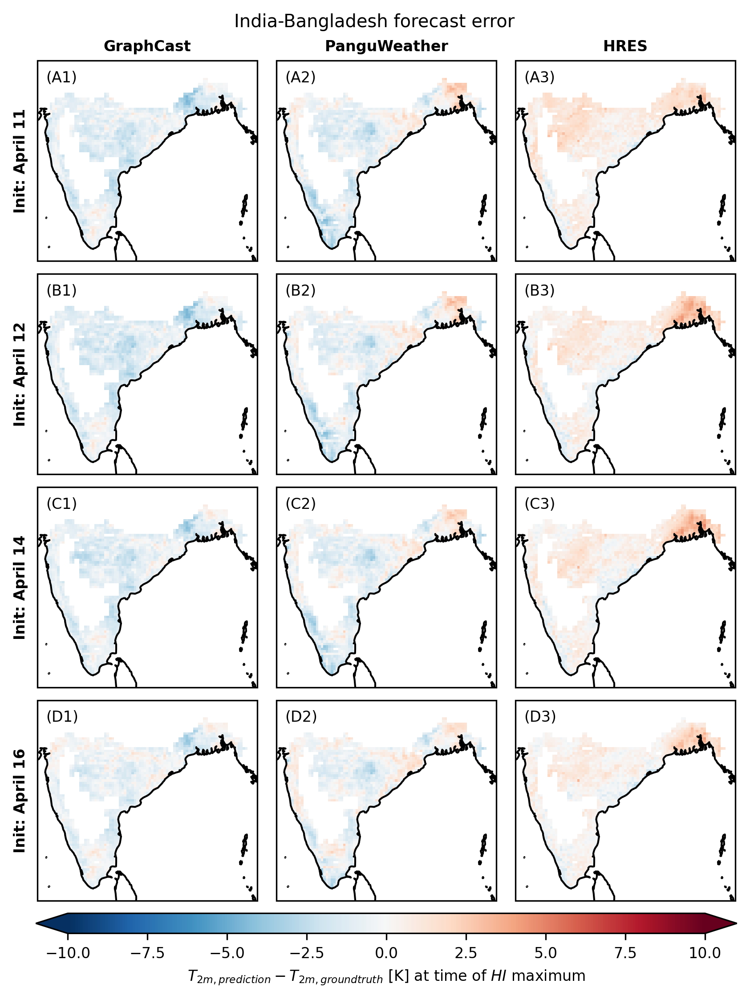

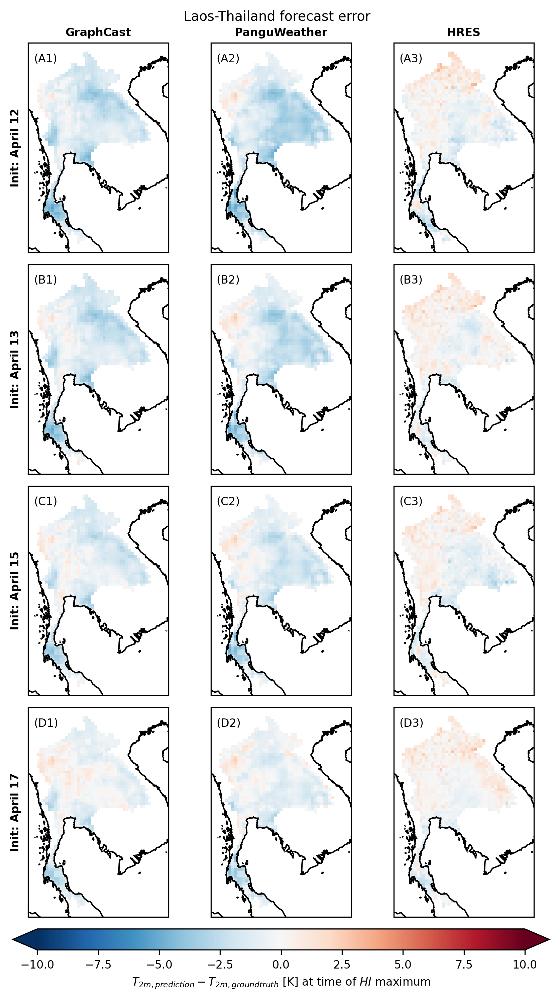

In [46]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = -10
vmax = 10
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 1, 3, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name) in enumerate(zip(fc_names, gt_names, strict=False)):
            fc = get_forecast(
                fc=fc_data["2m_temperature"].sel(forecast=fc_name, level=-1).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["2m_temperature"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="RdBu_r", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$T_{2m, prediction} - T_{2m, ground truth}$ [K] at time of $HI$ maximum",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_surface_temperature_{country_label}.png"
    )

same for humidity.

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

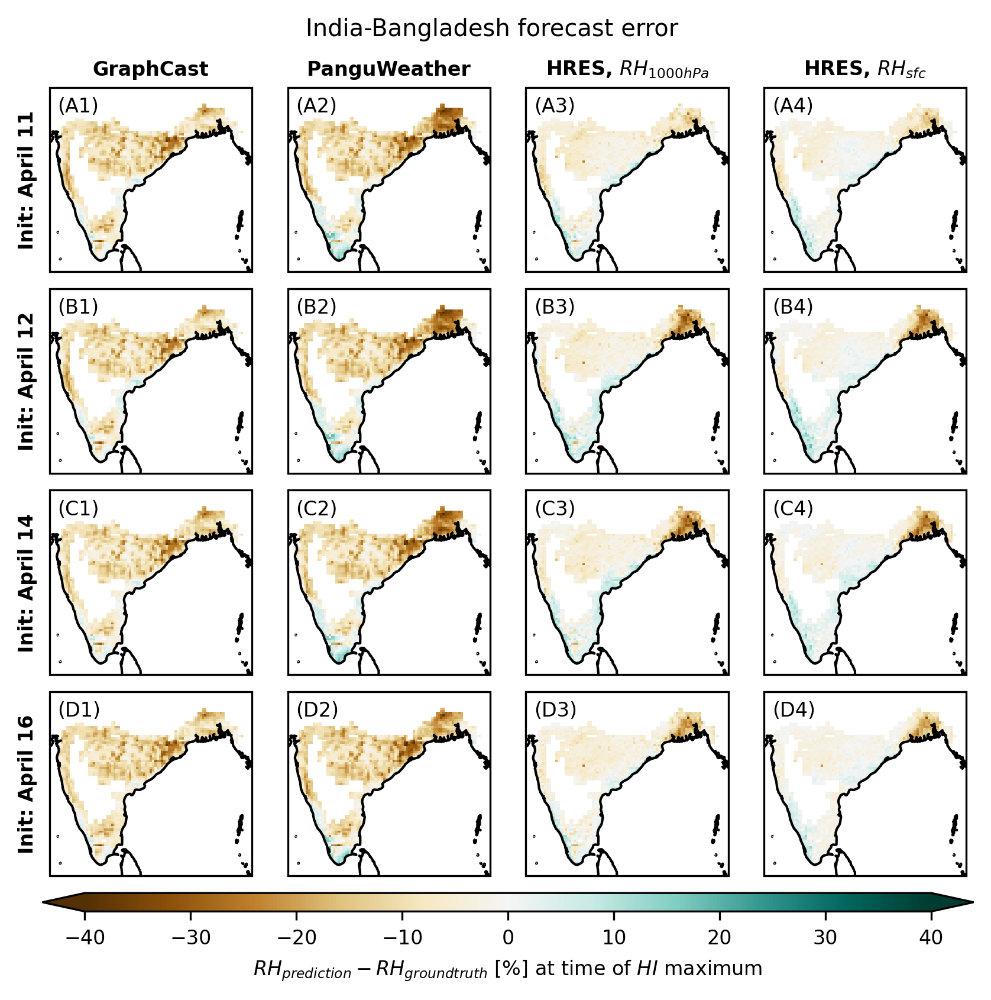

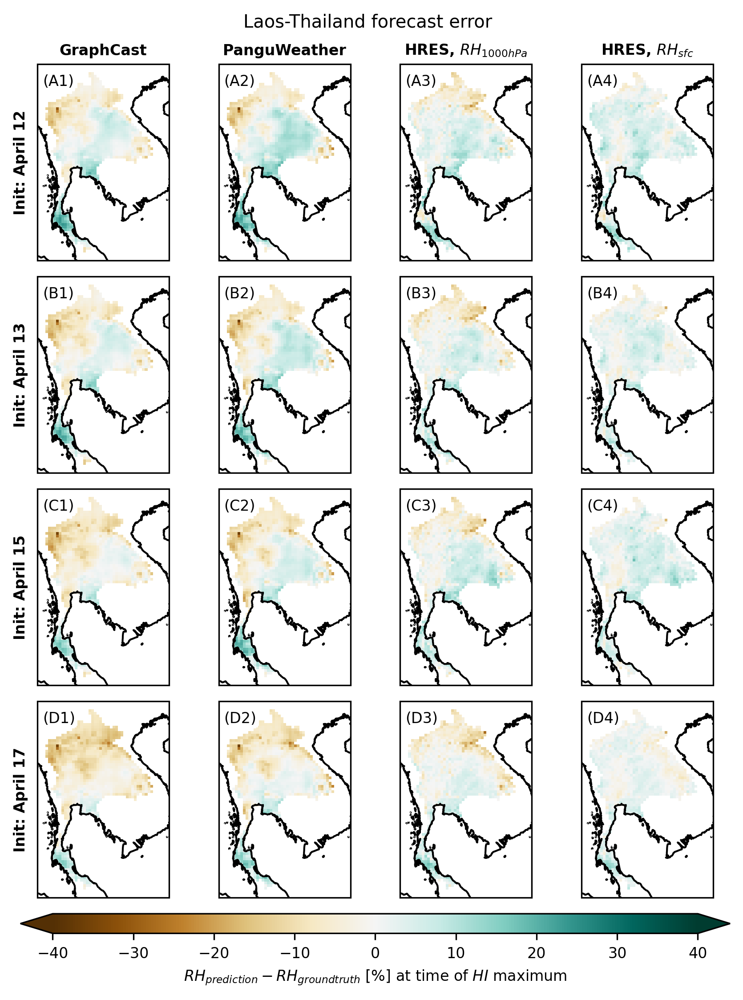

In [47]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES", "HRES"]
level_names = [1000, 1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]
vmin = -40
vmax = 40
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 4))
    gs = gridspec.GridSpec(
        len(lts) + 1, 4, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["relative_humidity"]
                .sel(forecast=fc_name, level=lv_name)
                .sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["relative_humidity"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="BrBG", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")
            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=[
            "GraphCast",
            "PanguWeather",
            "HRES, $RH_{1000hPa}$",
            "HRES, $RH_{sfc}$",
        ],
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$RH_{prediction} - RH_{ground truth}$ [%] at time of $HI$ maximum",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_surface_humidity_hres_versions_{country_label}.png"
    )

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

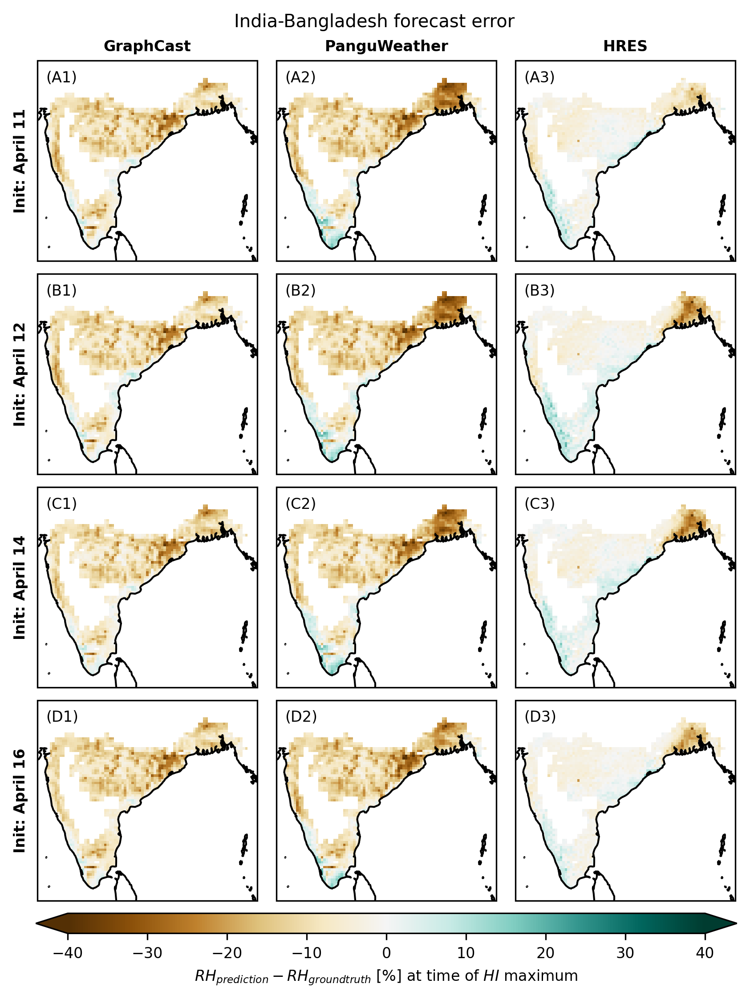

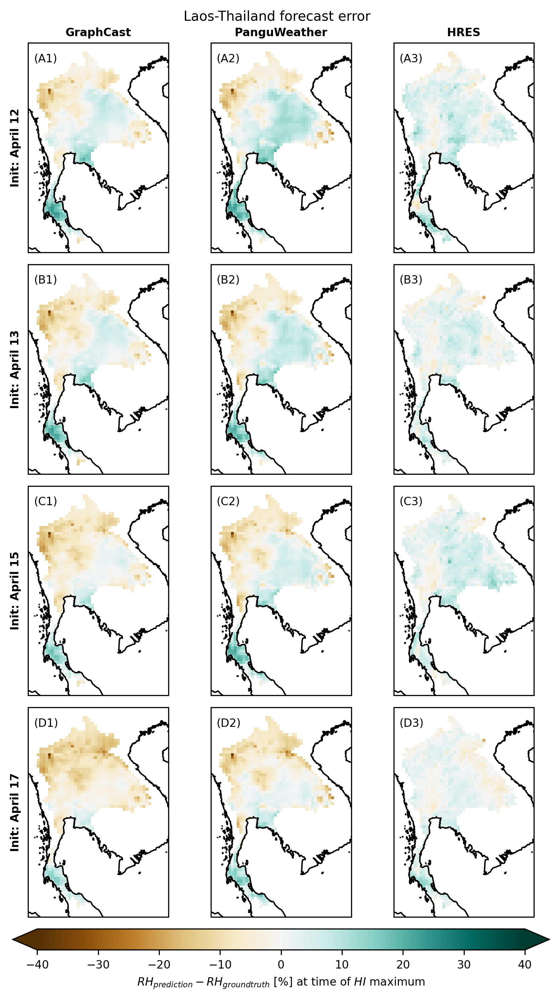

In [48]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = -40
vmax = 40
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 1, 3, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["relative_humidity"]
                .sel(forecast=fc_name, level=lv_name)
                .sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["relative_humidity"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="BrBG", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")
            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$RH_{prediction} - RH_{ground truth}$ [%] at time of $HI$ maximum",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_surface_humidity_{country_label}.png"
    )

again with additional column for alternative HRES computation:

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

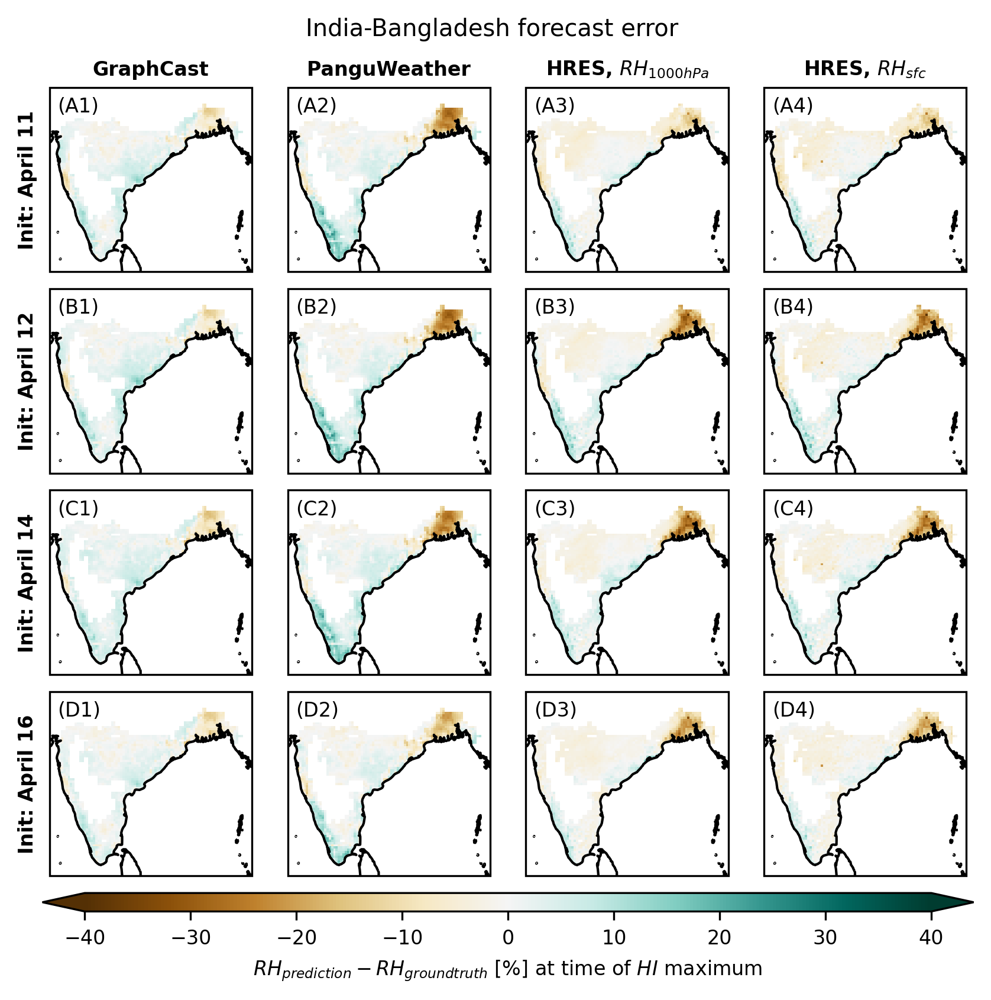

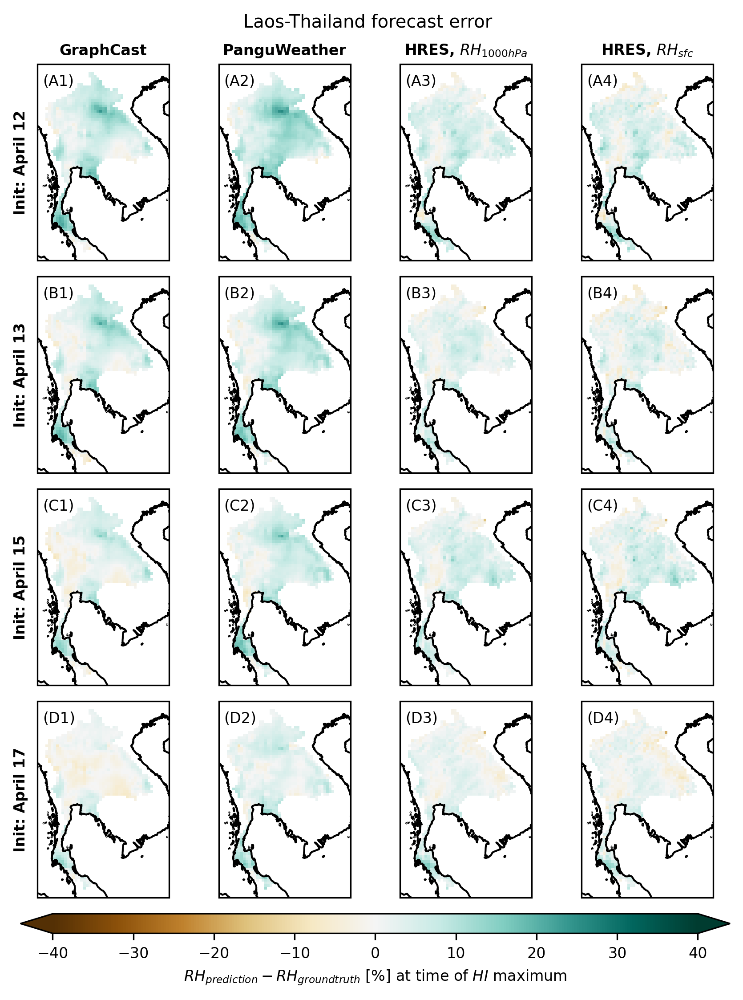

In [49]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES", "HRES"]
level_names = [1000, 1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]
vmin = -40
vmax = 40
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 4))
    gs = gridspec.GridSpec(
        len(lts) + 1, 4, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["relative_humidity"]
                .sel(forecast=fc_name, level=lv_name)
                .sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["relative_humidity"]
                .sel(source=gt_name, level=lv_name)
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="BrBG", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=[
            "GraphCast",
            "PanguWeather",
            "HRES, $RH_{1000hPa}$",
            "HRES, $RH_{sfc}$",
        ],
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$RH_{prediction} - RH_{ground truth}$ [%] at time of $HI$ maximum",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_same_level_humidity_hres_versions_{country_label}.png"
    )

use same level for both GT and prediction, but use surface GT heat index to determine timing of daily maximum:

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

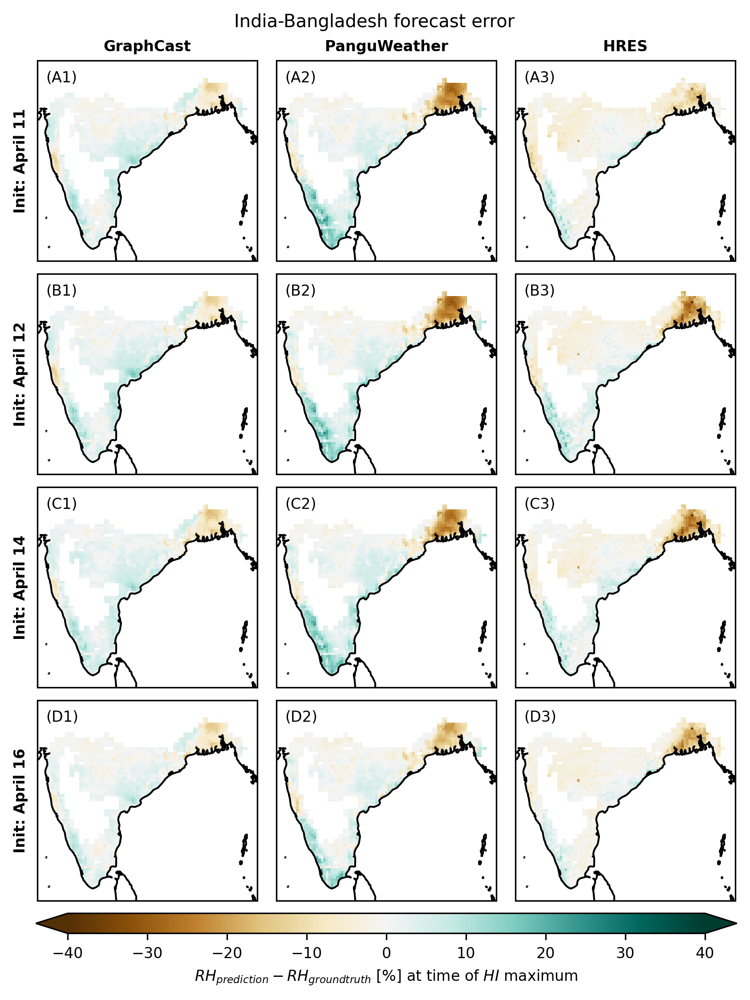

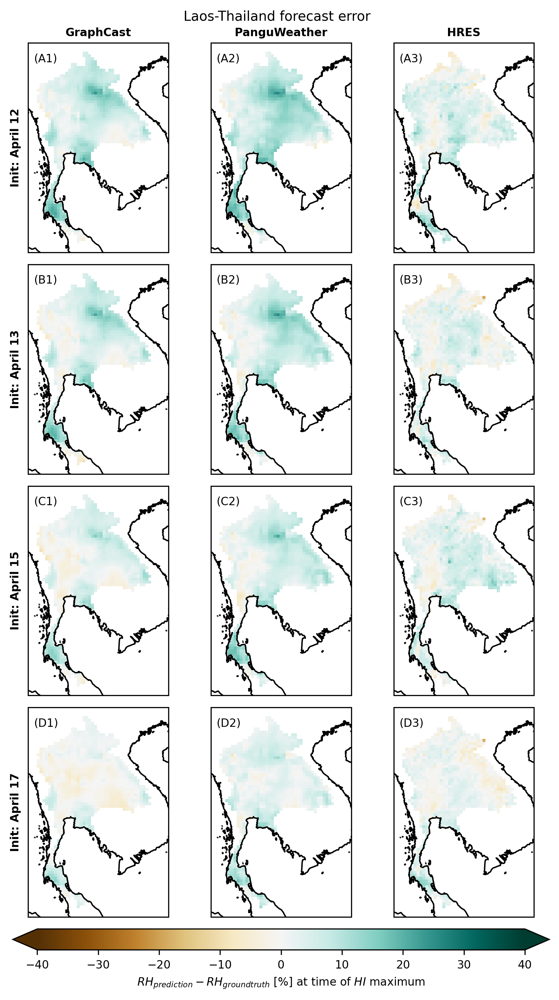

In [50]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = -40
vmax = 40
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 1, 3, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["relative_humidity"]
                .sel(forecast=fc_name, level=lv_name)
                .sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["relative_humidity"]
                .sel(source=gt_name, level=lv_name)
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="BrBG", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$RH_{prediction} - RH_{ground truth}$ [%] at time of $HI$ maximum",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_same_level_humidity_{country_label}.png"
    )

same for heat index:

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

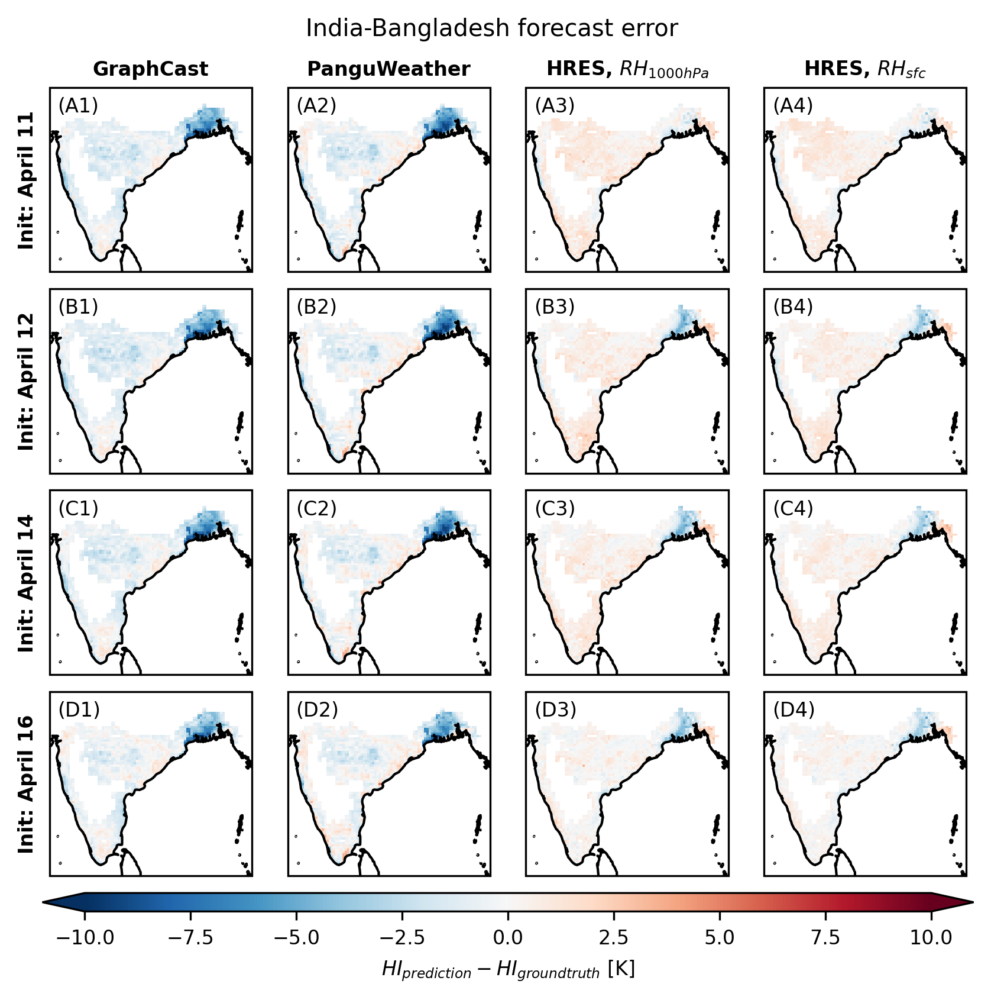

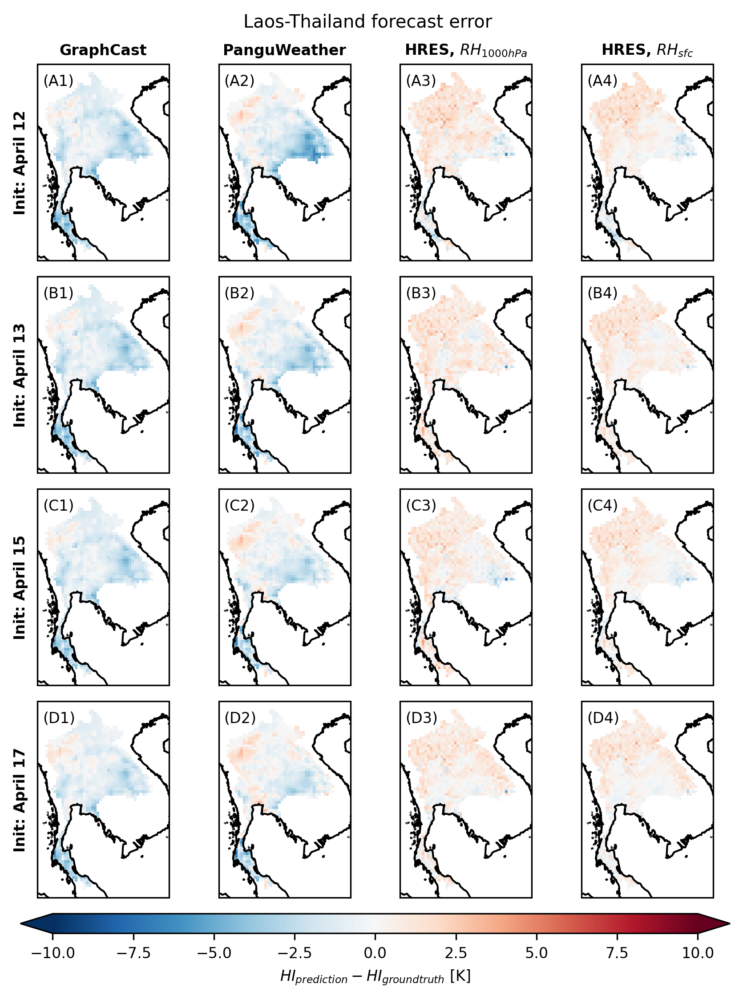

In [51]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES", "HRES"]
level_names = [1000, 1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]
vmin = -10
vmax = 10
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 4))
    gs = gridspec.GridSpec(
        len(lts) + 1, 4, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=lv_name)
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt_sfc = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt_sfc)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt_sfc),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="RdBu_r", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=[
            "GraphCast",
            "PanguWeather",
            "HRES, $RH_{1000hPa}$",
            "HRES, $RH_{sfc}$",
        ],
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$HI_{prediction} - HI_{ground truth}$ [K]",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_level_hres_versions_{country_label}.png"
    )

same without additional column for HRES alternative version.

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

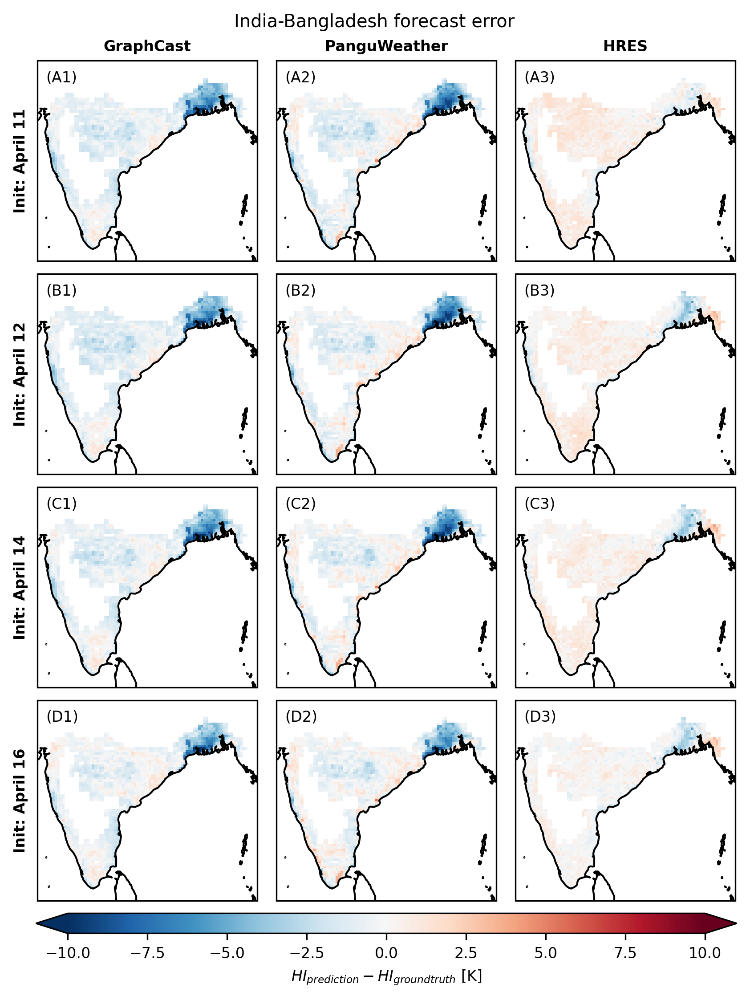

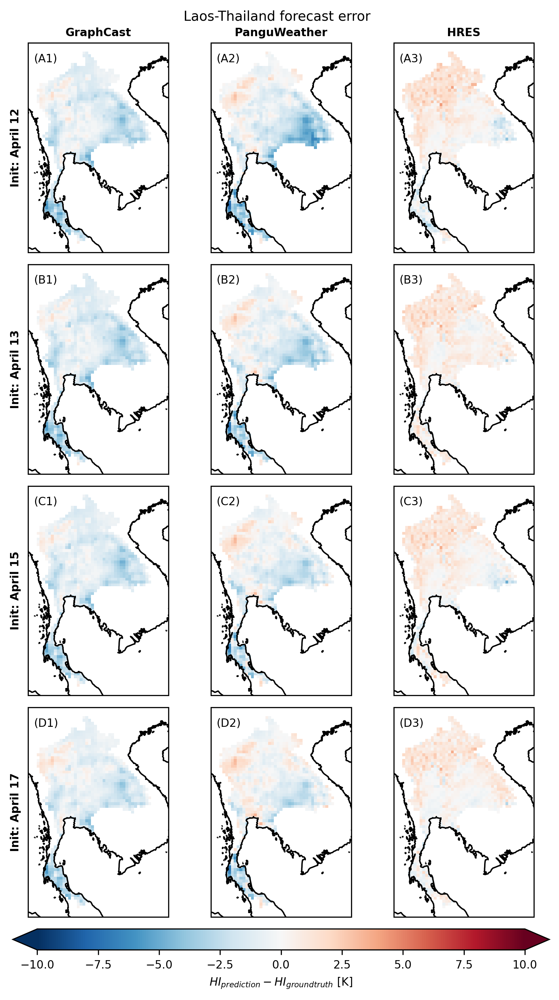

In [52]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0"]
vmin = -10
vmax = 10
aspect_ratio_single_plot = [1.0, 0.75]

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts)) / 3))
    gs = gridspec.GridSpec(
        len(lts) + 1, 3, figure=fig, height_ratios=(len(lts)) * [1] + [0.1]
    )

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, gt_name, lv_name) in enumerate(
            zip(fc_names, gt_names, level_names, strict=False)
        ):
            fc = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=lv_name)
                .sel(box)
                .sel(time=t_slice)
            )
            hi_gt_sfc = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )
            res = clip_data(
                mean_at_time_of_daily_hi_max(fc, hi_gt=hi_gt_sfc)
                - mean_at_time_of_daily_hi_max(gt, hi_gt=hi_gt_sfc),
                mask=mask,
            )

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap="RdBu_r", vmax=vmax, vmin=vmin)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")

            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ],
        fontweight="bold",
    )

    ax_cbar = fig.add_subplot(gs[-1, :])
    plt.colorbar(
        m,
        cax=ax_cbar,
        label=r"$HI_{prediction} - HI_{ground truth}$ [K]",
        orientation="horizontal",
        extend="both",
    )

    fig.suptitle(country_label + " forecast error")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_forecast_from_different_starts_bias_wrt_level_{country_label}.png"
    )

## histogram plots

In [53]:
hist_fc = {}
weights_fc = {}
lts = np.array([5])

fc_names = ["GraphCast", "PanguWeather", "HRES", "HRES"]
level_names = [1000, 1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]


for box, l_c, time_slice, mask in zip(
    boxes, labels_countries, slices, masks, strict=False
):
    start_dates = time_slice.start - lts * np.timedelta64(1, "D")
    hist_fc[l_c] = []
    for fc_ds, lh, gt_ds in zip(fc_names, level_names, gt_names, strict=True):
        hist_fc[l_c].append({})
        for start_date in start_dates:
            res = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_ds, level=lh).sel(box),
                ts_event=time_slice,
                start_date=start_date,
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_ds, level=lh)
                .sel(box)
                .sel(time=time_slice)
            )
            hist_fc[l_c][-1][start_date] = clip_data(
                mean_at_time_of_daily_hi_max(res, hi_gt=hi_gt), mask=mask
            )
    weights_fc[l_c] = clip_data(ERA5_Area.sel(**box), mask)

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


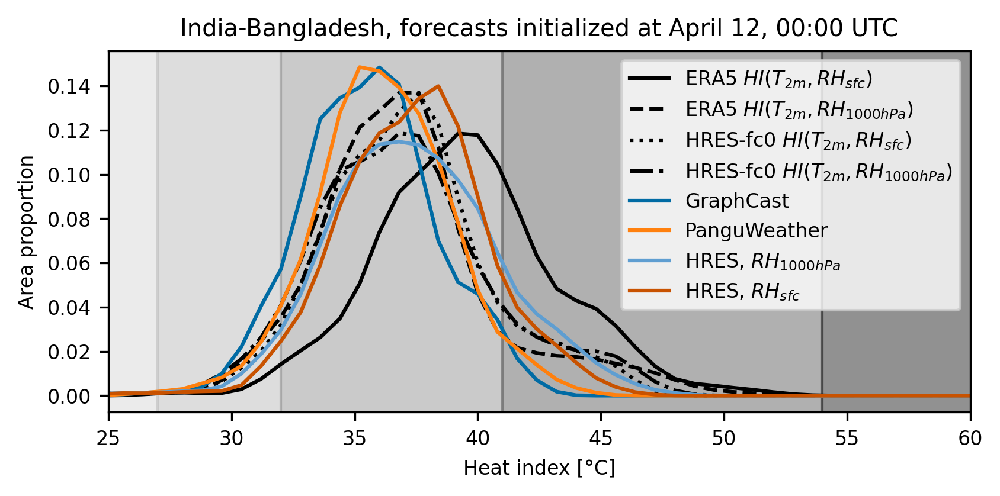

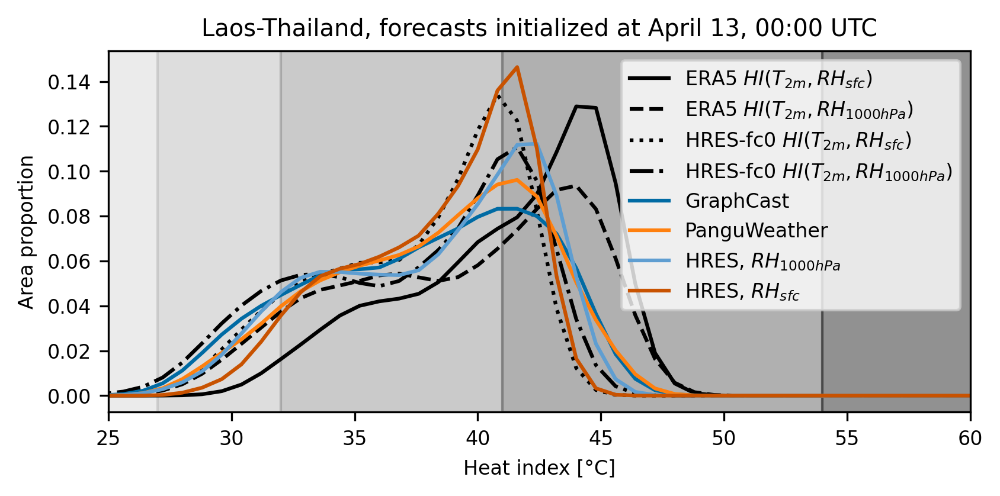

In [54]:
aspect_ratio_single_plot = 2

thres = np.linspace(np.amin(thresholds), np.amax(thresholds), 101)

n_cols = len(lts)
linestyles = ["solid", "dashed", "dotted", "dashdot"]

for l_c in labels_countries:
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches(textwidth, textwidth * 1 / aspect_ratio_single_plot)

    # surface
    data = hist_max_same_level[l_c]["ERA5"][-1].to_numpy().flatten()
    w = weights[l_c].to_numpy().flatten()
    kde = stats.gaussian_kde(
        data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
    )
    density = kde.evaluate(thres)
    ax.plot(
        thres,
        density,
        label=r"ERA5 $HI(T_{2m}, RH_{sfc})$",
        c="k",
        linestyle=linestyles[0],
    )
    data = hist_max_same_level[l_c]["ERA5"][1000].to_numpy().flatten()
    w = weights[l_c].to_numpy().flatten()
    kde = stats.gaussian_kde(
        data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
    )
    density = kde.evaluate(thres)
    ax.plot(
        thres,
        density,
        label=r"ERA5 $HI(T_{2m}, RH_{1000hPa})$",
        c="k",
        linestyle=linestyles[1],
    )

    # HRES
    data = hist_max_same_level[l_c]["HRES_t0"][-1].to_numpy().flatten()
    w = weights[l_c].to_numpy().flatten()
    kde = stats.gaussian_kde(
        data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
    )
    density = kde.evaluate(thres)
    ax.plot(
        thres,
        density,
        label=r"HRES-fc0 $HI(T_{2m}, RH_{sfc})$",
        c="k",
        linestyle=linestyles[2],
    )

    data = hist_max_same_level[l_c]["HRES_t0"][1000].to_numpy().flatten()
    w = weights[l_c].to_numpy().flatten()
    kde = stats.gaussian_kde(
        data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
    )
    density = kde.evaluate(thres)
    ax.plot(
        thres,
        density,
        label=r"HRES-fc0 $HI(T_{2m}, RH_{1000hPa})$",
        c="k",
        linestyle=linestyles[3],
    )

    # forecasts:
    for l_fc, data_fcs in zip(
        ["GraphCast", "PanguWeather", "HRES, $RH_{1000hPa}$", "HRES, $RH_{sfc}$"],
        hist_fc[l_c],
        strict=False,
    ):
        for j, (_, data_fc) in enumerate(data_fcs.items()):
            data = data_fc.to_numpy().flatten()
            w = weights_fc[l_c].to_numpy().flatten()
            kde = stats.gaussian_kde(
                data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
            )
            density = kde.evaluate(thres)
            if j == len(data_fcs) - 1:
                ax.plot(
                    thres,
                    density,
                    label=f"{l_fc}",
                )
            else:
                ax.plot(thres, density)
    ax.set_ylabel("Area proportion")
    ax.set_xlabel("Heat index [°C]")
    tstamp = pd.Timestamp(list(data_fcs.keys())[0])
    ax.set_title(
        f"{l_c}, forecasts initialized at {tstamp.date().strftime('%B %d')}, {tstamp.hour:02d}:00 UTC"
    )
    ax.set_xlim(25, 60)

    ax.axvspan(thresholds[0], inner_bounds[0], alpha=0.5, color=colors[0])
    ax.axvspan(inner_bounds[0], inner_bounds[1], alpha=0.5, color=colors[1])
    ax.axvspan(inner_bounds[1], inner_bounds[2], alpha=0.5, color=colors[2])
    ax.axvspan(inner_bounds[2], inner_bounds[3], alpha=0.5, color=colors[3])
    ax.axvspan(inner_bounds[3], thresholds[-1], alpha=0.5, color=colors[4])
    ax.legend()

    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_area_statistics_forecasts_all_1000hPa_{l_c}.png"
    )

In an earlier version we used surface HI to determine timing of maximum heat index:

In [55]:
hist_fc = {}
weights_fc = {}
lts = np.array([5])

fc_names = ["GraphCast", "PanguWeather", "HRES", "HRES"]
level_names = [1000, 1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]


for box, l_c, time_slice, mask in zip(
    boxes, labels_countries, slices, masks, strict=False
):
    start_dates = time_slice.start - lts * np.timedelta64(1, "D")
    hist_fc[l_c] = []
    for fc_ds, lh, gt_ds in zip(fc_names, level_names, gt_names, strict=True):
        hist_fc[l_c].append({})
        for start_date in start_dates:
            res = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_ds, level=lh).sel(box),
                ts_event=time_slice,
                start_date=start_date,
            )
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_ds, level=-1)
                .sel(box)
                .sel(time=time_slice)
            )
            hist_fc[l_c][-1][start_date] = clip_data(
                mean_at_time_of_daily_hi_max(res, hi_gt=hi_gt), mask=mask
            )
    weights_fc[l_c] = clip_data(ERA5_Area.sel(**box), mask)

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

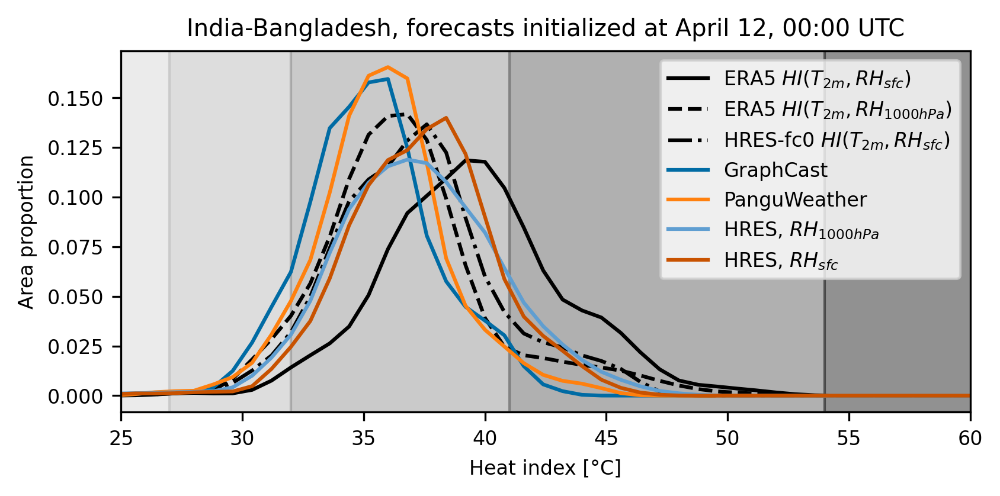

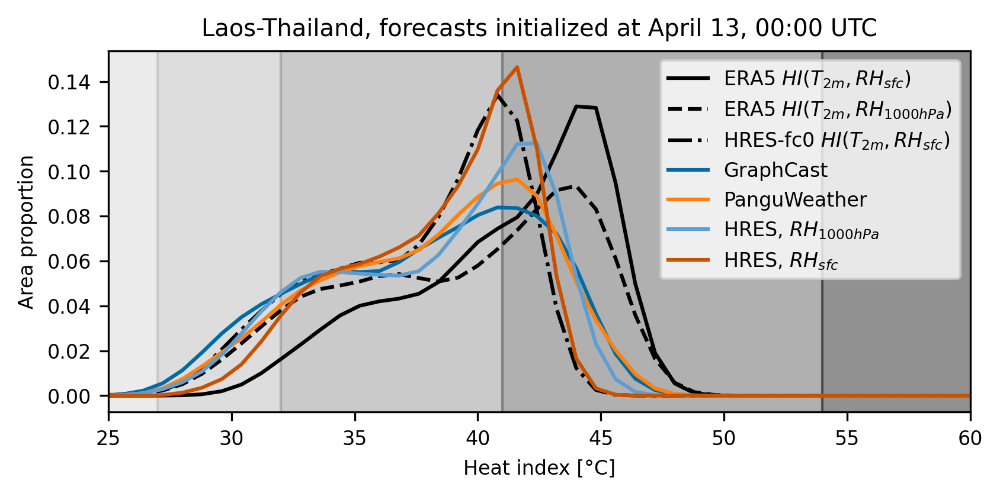

In [56]:
aspect_ratio_single_plot = 2

thres = np.linspace(np.amin(thresholds), np.amax(thresholds), 101)

n_cols = len(lts)
linestyles = ["solid", "dashed", "dotted", "dashdot"]

for i, l_c in enumerate(labels_countries):
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches(textwidth, textwidth * 1 / aspect_ratio_single_plot)

    # surface
    data = hist[l_c]["ERA5"][-1].to_numpy().flatten()
    w = weights[l_c].to_numpy().flatten()
    kde = stats.gaussian_kde(
        data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
    )
    density = kde.evaluate(thres)
    ax.plot(
        thres,
        density,
        label=r"ERA5 $HI(T_{2m}, RH_{sfc})$",
        c="k",
        linestyle=linestyles[0],
    )
    data = hist[l_c]["ERA5"][1000].to_numpy().flatten()
    w = weights[l_c].to_numpy().flatten()
    kde = stats.gaussian_kde(
        data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
    )
    density = kde.evaluate(thres)
    ax.plot(
        thres,
        density,
        label=r"ERA5 $HI(T_{2m}, RH_{1000hPa})$",
        c="k",
        linestyle=linestyles[1],
    )

    # HRES
    data = hist[l_c]["HRES_t0"][-1].to_numpy().flatten()
    w = weights[l_c].to_numpy().flatten()
    kde = stats.gaussian_kde(
        data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
    )
    density = kde.evaluate(thres)
    ax.plot(
        thres,
        density,
        label=r"HRES-fc0 $HI(T_{2m}, RH_{sfc})$",
        c="k",
        linestyle=linestyles[-1],
    )

    # forecasts:
    for k, (l_fc, data_fcs) in enumerate(
        zip(
            ["GraphCast", "PanguWeather", "HRES, $RH_{1000hPa}$", "HRES, $RH_{sfc}$"],
            hist_fc[l_c],
            strict=False,
        )
    ):
        for j, (_, data_fc) in enumerate(data_fcs.items()):
            data = data_fc.to_numpy().flatten()
            w = weights_fc[l_c].to_numpy().flatten()
            kde = stats.gaussian_kde(
                data[~np.isnan(data)], weights=w[~np.isnan(data)], bw_method="silverman"
            )
            density = kde.evaluate(thres)
            if j == len(data_fcs) - 1:
                ax.plot(
                    thres,
                    density,
                    label=f"{l_fc}",
                )
            else:
                ax.plot(thres, density)
    ax.set_ylabel("Area proportion")
    ax.set_xlabel("Heat index [°C]")
    tstamp = pd.Timestamp(list(data_fcs.keys())[0])
    ax.set_title(
        f"{l_c}, forecasts initialized at {tstamp.date().strftime('%B %d')}, {tstamp.hour:02d}:00 UTC"
    )
    ax.set_xlim(25, 60)

    ax.axvspan(thresholds[0], inner_bounds[0], alpha=0.5, color=colors[0])
    ax.axvspan(inner_bounds[0], inner_bounds[1], alpha=0.5, color=colors[1])
    ax.axvspan(inner_bounds[1], inner_bounds[2], alpha=0.5, color=colors[2])
    ax.axvspan(inner_bounds[2], inner_bounds[3], alpha=0.5, color=colors[3])
    ax.axvspan(inner_bounds[3], thresholds[-1], alpha=0.5, color=colors[4])
    ax.legend()

    plt.tight_layout()
    plt.savefig(f"images/2023_humid_heatwave_area_statistics_forecasts_{l_c}.png")

Back to map plots. 
Calculate HI bias w.r.t. surface level HI.

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

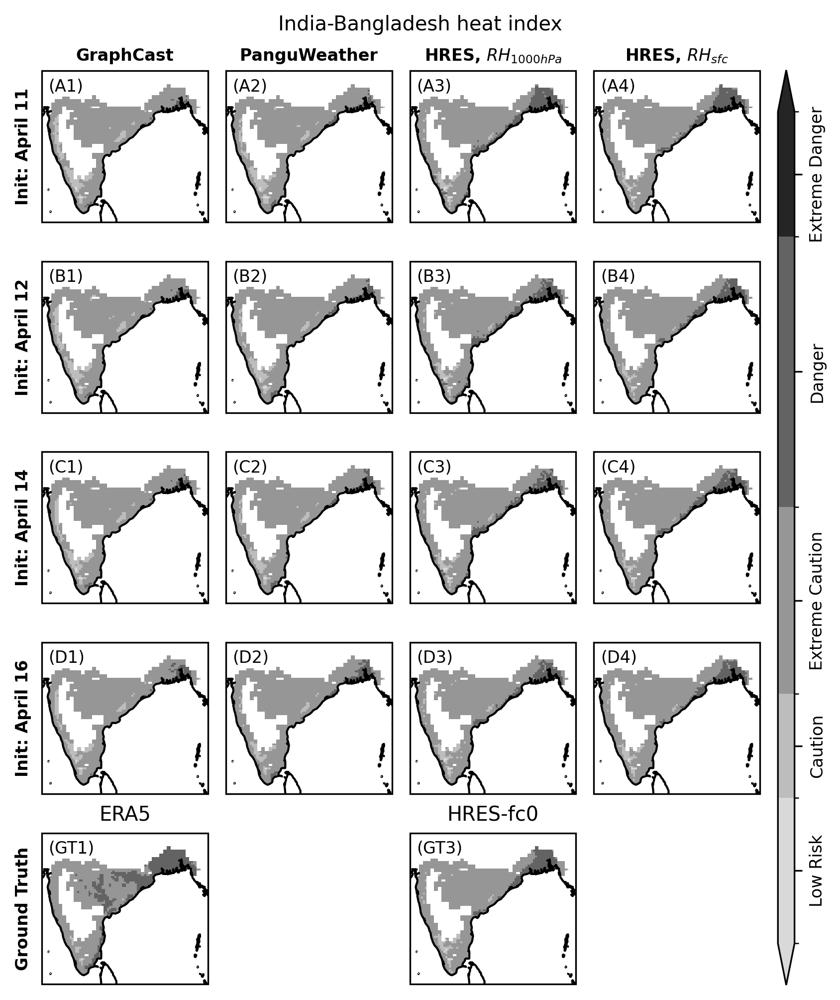

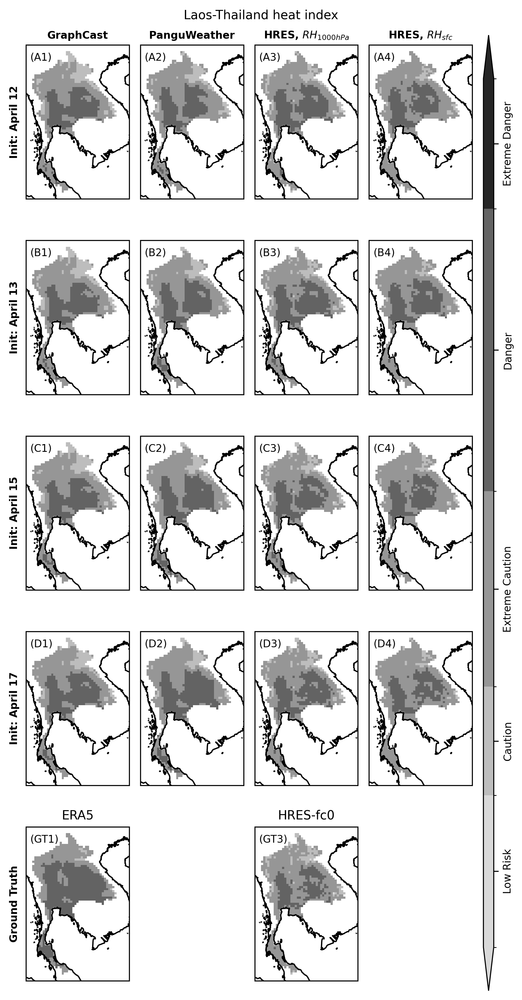

In [57]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES", "HRES"]
level_names = [1000, 1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]
aspect_ratios_single_plot = [1.05, 0.65]


# heat index danger levels
cmap = matplotlib.colors.ListedColormap(colors)
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts) + 1) / 4))
    gs = gridspec.GridSpec(len(lts) + 1, 5, figure=fig, width_ratios=[1, 1, 1, 1, 0.1])

    ax_era5 = fig.add_subplot(gs[-1, 0], projection=ccrs.PlateCarree())
    ax_hres_t0 = fig.add_subplot(gs[-1, 2], projection=ccrs.PlateCarree())

    hi_gt = (
        gt_data["heat_index"].sel(source="ERA5", level=-1).sel(box).sel(time=t_slice)
    )

    clip_data(
        mean_at_time_of_daily_hi_max(
            gt_data["heat_index"].sel(source="ERA5", level=-1).sel(**box, time=t_slice),
            hi_gt=hi_gt,
        ),
        mask=mask,
    ).plot(ax=ax_era5, add_colorbar=False, cmap=cmap, norm=norm)

    hi_gt = (
        gt_data["heat_index"].sel(source="HRES_t0", level=-1).sel(box).sel(time=t_slice)
    )

    clip_data(
        mean_at_time_of_daily_hi_max(
            gt_data["heat_index"]
            .sel(source="HRES_t0", level=-1)
            .sel(**box, time=t_slice),
            hi_gt=hi_gt,
        ),
        mask=mask,
    ).plot(ax=ax_hres_t0, add_colorbar=False, cmap=cmap, norm=norm)

    ax_era5.coastlines()
    ax_era5.set_title("ERA5")

    ax_hres_t0.coastlines()
    ax_hres_t0.set_title("HRES-fc0")

    add_label_to_axes(ax_era5, "(GT1)")
    add_label_to_axes(ax_hres_t0, "(GT3)")

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, lv_name, gt_name) in enumerate(
            zip(fc_names, level_names, gt_names, strict=False)
        ):
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )

            res = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            res = clip_data(mean_at_time_of_daily_hi_max(res, hi_gt=hi_gt), mask=mask)

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap=cmap, norm=norm)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")
            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=[
            "GraphCast",
            "PanguWeather",
            "HRES, $RH_{1000hPa}$",
            "HRES, $RH_{sfc}$",
        ],
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ]
        + ["Ground Truth"],
        fontweight="bold",
    )

    ax_cb = plt.subplot(gs[:, -1])
    ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
    fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
    cbar = plt.colorbar(
        mappable=m,
        cax=ax_cb,
        format=fmt,
        ticks=ticks,
        extend="both",
        spacing="proportional",
    )
    cbar.ax.tick_params(axis="y", labelrotation=90)
    cbar.ax.set_yticklabels(cbar.ax.get_yticklabels(), verticalalignment="center")

    fig.suptitle(country_label + " heat index")
    plt.tight_layout()
    plt.savefig(
        f"images/2023_humid_heatwave_heat_index_map_hres_versions_{country_label}.png"
    )

same without additional column

/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")


/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.py:27: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop("time")
/tmp/ipykernel_3520503/516749836.p

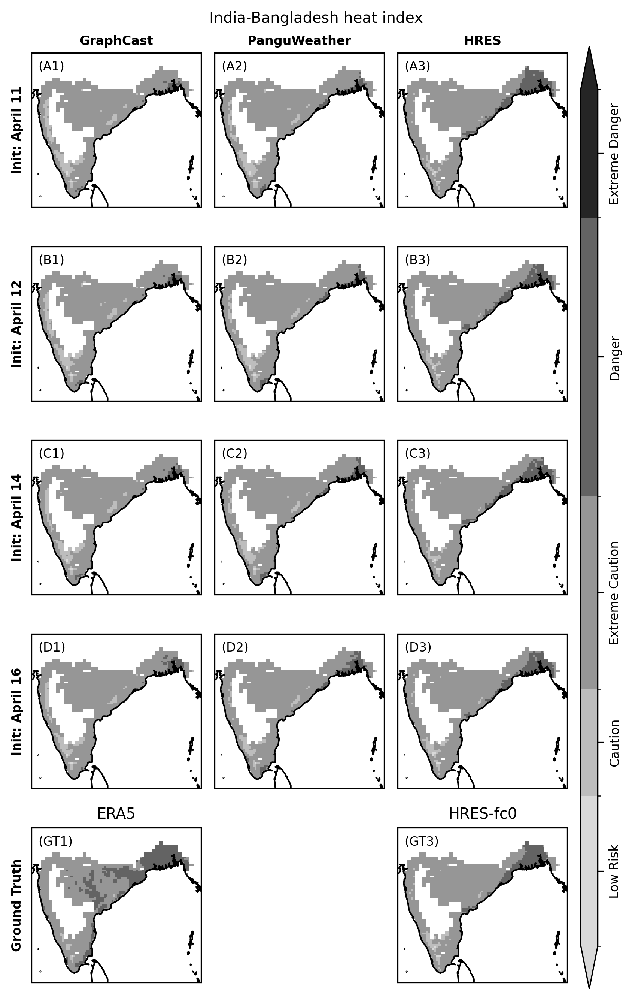

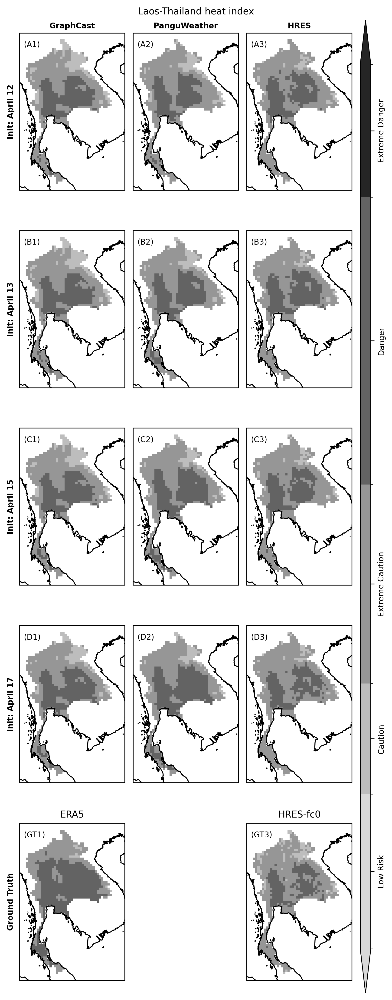

In [58]:
lts = np.flip(np.array([1, 3, 5, 6]))
fc_names = ["GraphCast", "PanguWeather", "HRES"]
level_names = [1000, 1000, -1]
gt_names = ["ERA5", "ERA5", "HRES_t0", "HRES_t0"]
aspect_ratios_single_plot = [1.05, 0.65]


# heat index danger levels
cmap = matplotlib.colors.ListedColormap(colors)
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

for ar, mask, box, country_label, t_slice in zip(
    aspect_ratios_single_plot, masks, boxes, labels_countries, slices, strict=True
):
    fig = plt.figure(figsize=(textwidth, textwidth / ar * (len(lts) + 1) / 3))
    gs = gridspec.GridSpec(len(lts) + 1, 4, figure=fig, width_ratios=[1, 1, 1, 0.1])

    ax_era5 = fig.add_subplot(gs[-1, 0], projection=ccrs.PlateCarree())
    ax_hres_t0 = fig.add_subplot(gs[-1, 2], projection=ccrs.PlateCarree())

    hi_gt = (
        gt_data["heat_index"].sel(source="ERA5", level=-1).sel(box).sel(time=t_slice)
    )

    clip_data(
        mean_at_time_of_daily_hi_max(
            gt_data["heat_index"].sel(source="ERA5", level=-1).sel(**box, time=t_slice),
            hi_gt=hi_gt,
        ),
        mask=mask,
    ).plot(ax=ax_era5, add_colorbar=False, cmap=cmap, norm=norm)

    hi_gt = (
        gt_data["heat_index"].sel(source="HRES_t0", level=-1).sel(box).sel(time=t_slice)
    )

    clip_data(
        mean_at_time_of_daily_hi_max(
            gt_data["heat_index"]
            .sel(source="HRES_t0", level=-1)
            .sel(**box, time=t_slice),
            hi_gt=hi_gt,
        ),
        mask=mask,
    ).plot(ax=ax_hres_t0, add_colorbar=False, cmap=cmap, norm=norm)

    ax_era5.coastlines()
    ax_era5.set_title("ERA5")

    ax_hres_t0.coastlines()
    ax_hres_t0.set_title("HRES-fc0")

    add_label_to_axes(ax_era5, "(GT1)")
    add_label_to_axes(ax_hres_t0, "(GT3)")

    start_dates = t_slice.start - lts * np.timedelta64(1, "D")
    for i, start_date in enumerate(start_dates):
        for j, (fc_name, lv_name, gt_name) in enumerate(
            zip(fc_names, level_names, gt_names, strict=False)
        ):
            hi_gt = (
                gt_data["heat_index"]
                .sel(source=gt_name, level=-1)
                .sel(box)
                .sel(time=t_slice)
            )

            res = get_forecast(
                fc=fc_data["heat_index"].sel(forecast=fc_name, level=lv_name).sel(box),
                ts_event=t_slice,
                start_date=start_date,
            )
            res = clip_data(mean_at_time_of_daily_hi_max(res, hi_gt=hi_gt), mask=mask)

            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())

            m = res.plot(ax=ax, add_colorbar=False, cmap=cmap, norm=norm)

            ax.coastlines()
            ax.set_title("")

            if j == 0:
                ax.set_ylabel("test")
            add_label_to_axes(ax, f"({letters[i]}{j+1})")

    add_headers(
        fig=fig,
        col_headers=fc_names,
        row_headers=[
            f"Init: {pd.Timestamp(sd).date().strftime('%B %d')}" for sd in start_dates
        ]
        + ["Ground Truth"],
        fontweight="bold",
    )

    ax_cb = plt.subplot(gs[:, -1])
    ticks = (bounds[1:] - bounds[:-1]) / 2 + bounds[:-1]
    fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
    cbar = plt.colorbar(
        mappable=m,
        cax=ax_cb,
        format=fmt,
        ticks=ticks,
        extend="both",
        spacing="proportional",
    )
    cbar.ax.tick_params(axis="y", labelrotation=90)
    cbar.ax.set_yticklabels(cbar.ax.get_yticklabels(), verticalalignment="center")

    fig.suptitle(country_label + " heat index")
    plt.tight_layout()
    plt.savefig(f"images/2023_humid_heatwave_heat_index_map_{country_label}.png")

## Additional investigations of the differences between the ground truth datasets.

Get timesteps during which each data reaches the maximal heat index if the quantities computed at the surface are used.

In [59]:
t_era = get_time_of_daily_hi_max(
    clip_data(gt_data.sel(source="ERA5", level=-1)["heat_index"], mask=masks[0]).mean(
        ("latitude", "longitude")
    )
)

t_hres_t0 = get_time_of_daily_hi_max(
    clip_data(
        gt_data.sel(source="HRES_t0", level=-1)["heat_index"], mask=masks[0]
    ).mean(("latitude", "longitude"))
)

Plot time series of ground truth and forecast data set spatial means. Forecasts at the smallest possible timedelta (6h).

Laos Thailand region:

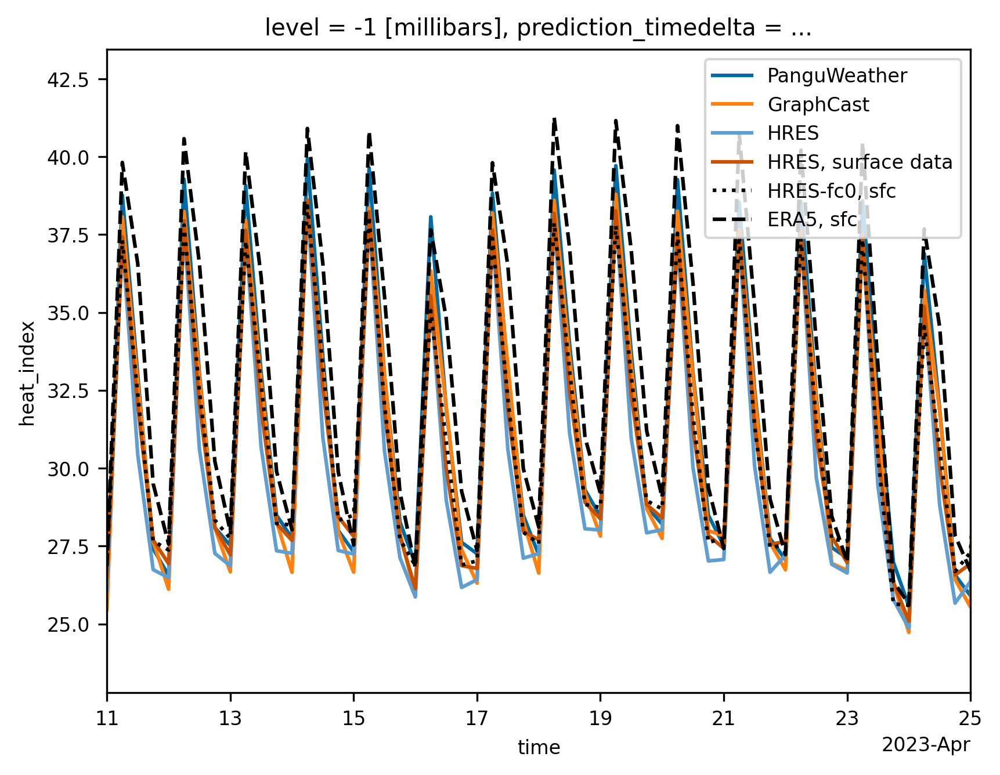

In [60]:
for fc_name in fc_data.forecast:
    dt = np.timedelta64(6, "h")
    d = fc_data.sel(forecast=fc_name, level=1000).sel(prediction_timedelta=dt)[
        "heat_index"
    ]
    d = d.assign_coords({"time": d.time + dt})

    clip_data(d, mask=masks[1]).mean(("latitude", "longitude")).plot(
        label=fc_name.to_numpy()
    )

dt = np.timedelta64(6, "h")
d = fc_data.sel(forecast="HRES", level=-1).sel(prediction_timedelta=dt)["heat_index"]
d = d.assign_coords({"time": d.time + dt})

clip_data(d, mask=masks[1]).mean(("latitude", "longitude")).plot(
    label="HRES, surface data"
)


# ground truths
clip_data(gt_data.sel(source="HRES_t0", level=-1)["heat_index"], mask=masks[1]).mean(
    ("latitude", "longitude")
).plot(label="HRES-fc0, sfc", linestyle="dotted", color="k")

clip_data(gt_data.sel(source="ERA5", level=-1)["heat_index"], mask=masks[1]).mean(
    ("latitude", "longitude")
).plot(label="ERA5, sfc", linestyle="dashed", color="k")

plt.xlim(np.datetime64("2023-04-11"), np.datetime64("2023-04-25"))
plt.legend()

India Bangladesh region:

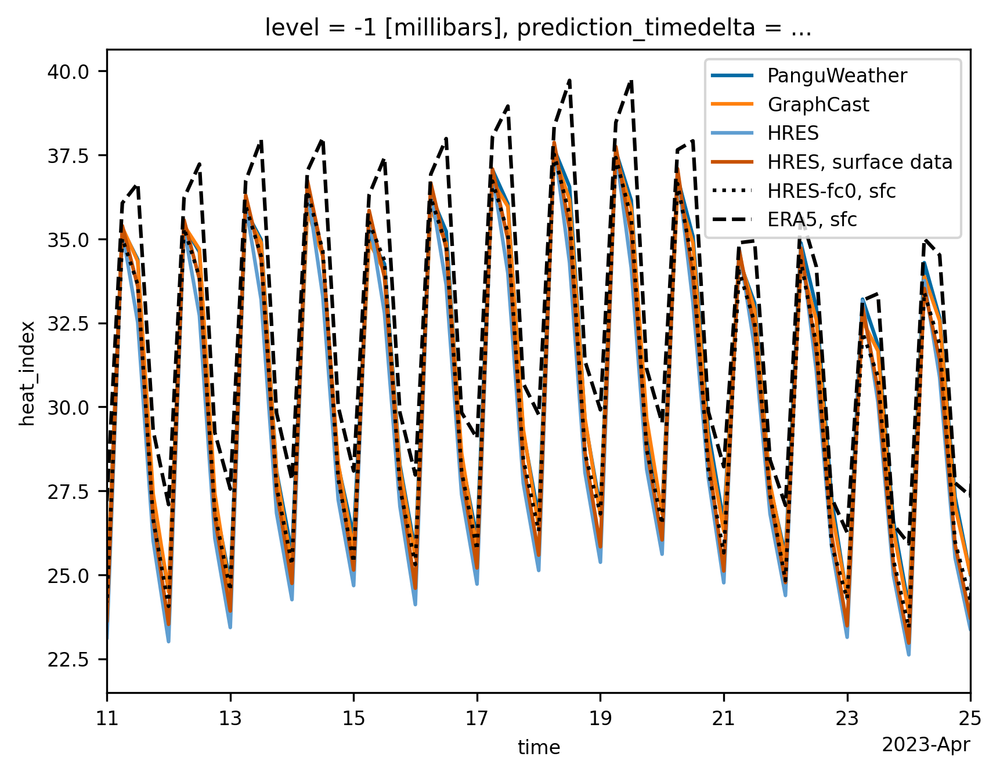

In [61]:
for fc_name in fc_data.forecast:
    dt = np.timedelta64(6, "h")
    d = fc_data.sel(forecast=fc_name, level=1000).sel(prediction_timedelta=dt)[
        "heat_index"
    ]
    d = d.assign_coords({"time": d.time + dt})

    clip_data(d, mask=masks[0]).mean(("latitude", "longitude")).plot(
        label=fc_name.to_numpy()
    )

dt = np.timedelta64(6, "h")
d = fc_data.sel(forecast="HRES", level=-1).sel(prediction_timedelta=dt)["heat_index"]
d = d.assign_coords({"time": d.time + dt})

clip_data(d, mask=masks[0]).mean(("latitude", "longitude")).plot(
    label="HRES, surface data"
)


# ground truths
clip_data(gt_data.sel(source="HRES_t0", level=-1)["heat_index"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="HRES-fc0, sfc", linestyle="dotted", color="k")

clip_data(gt_data.sel(source="ERA5", level=-1)["heat_index"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="ERA5, sfc", linestyle="dashed", color="k")

plt.xlim(np.datetime64("2023-04-11"), np.datetime64("2023-04-25"))
plt.legend()

India Bangladesh region. Compare only ground truth data sets:

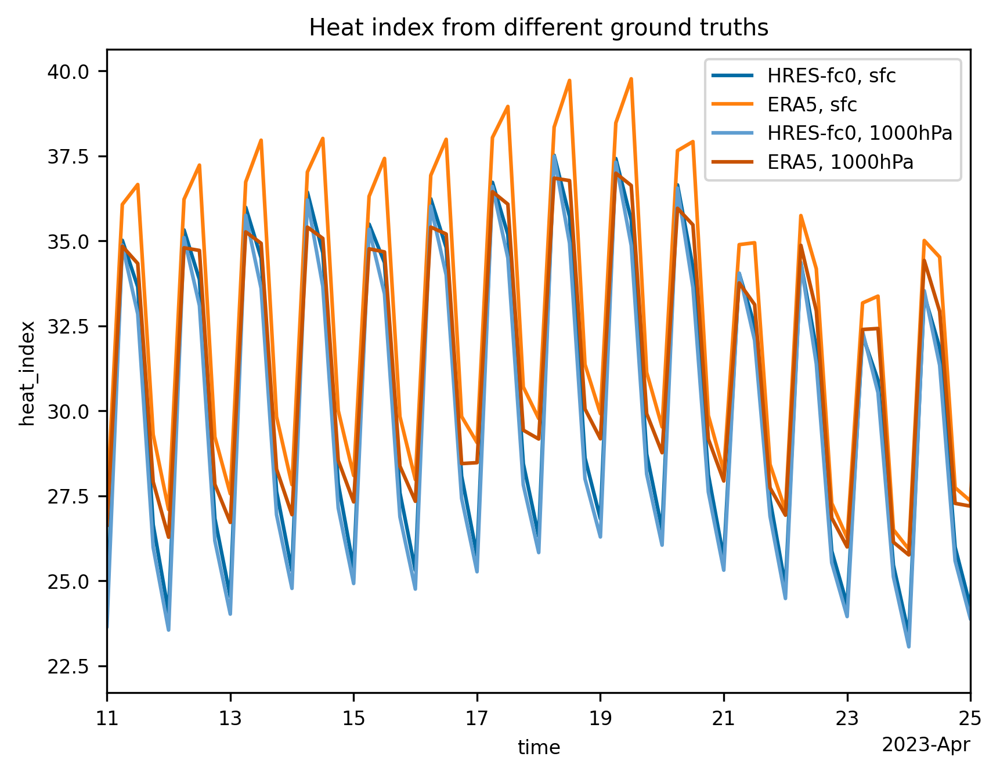

In [62]:
# ground truths
clip_data(gt_data.sel(source="HRES_t0", level=-1)["heat_index"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="HRES-fc0, sfc")

clip_data(gt_data.sel(source="ERA5", level=-1)["heat_index"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="ERA5, sfc")

clip_data(gt_data.sel(source="HRES_t0", level=1000)["heat_index"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="HRES-fc0, 1000hPa")

clip_data(gt_data.sel(source="ERA5", level=1000)["heat_index"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="ERA5, 1000hPa")

plt.title("Heat index from different ground truths")
plt.xlim(np.datetime64("2023-04-11"), np.datetime64("2023-04-25"))
plt.legend()

India-Bangladesh region. Relative humidity:

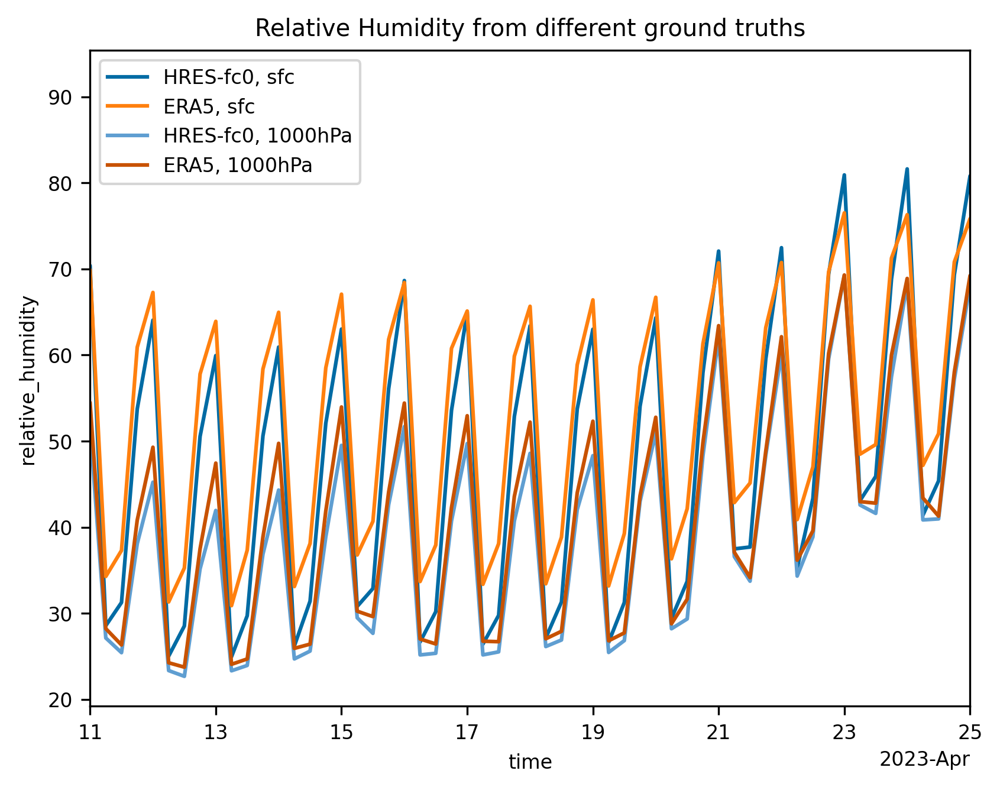

In [63]:
clip_data(
    gt_data.sel(source="HRES_t0", level=-1)["relative_humidity"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="HRES-fc0, sfc")

clip_data(
    gt_data.sel(source="ERA5", level=-1)["relative_humidity"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="ERA5, sfc")

clip_data(
    gt_data.sel(source="HRES_t0", level=1000)["relative_humidity"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="HRES-fc0, 1000hPa")

clip_data(
    gt_data.sel(source="ERA5", level=1000)["relative_humidity"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="ERA5, 1000hPa")


plt.title("Relative Humidity from different ground truths")
plt.xlim(np.datetime64("2023-04-11"), np.datetime64("2023-04-25"))
plt.legend()

India Bangladesh region, relative humidity:

Text(0.5, 1.0, '2m temperature and dewpoint temperature for ERA5 and HRES-fc0')

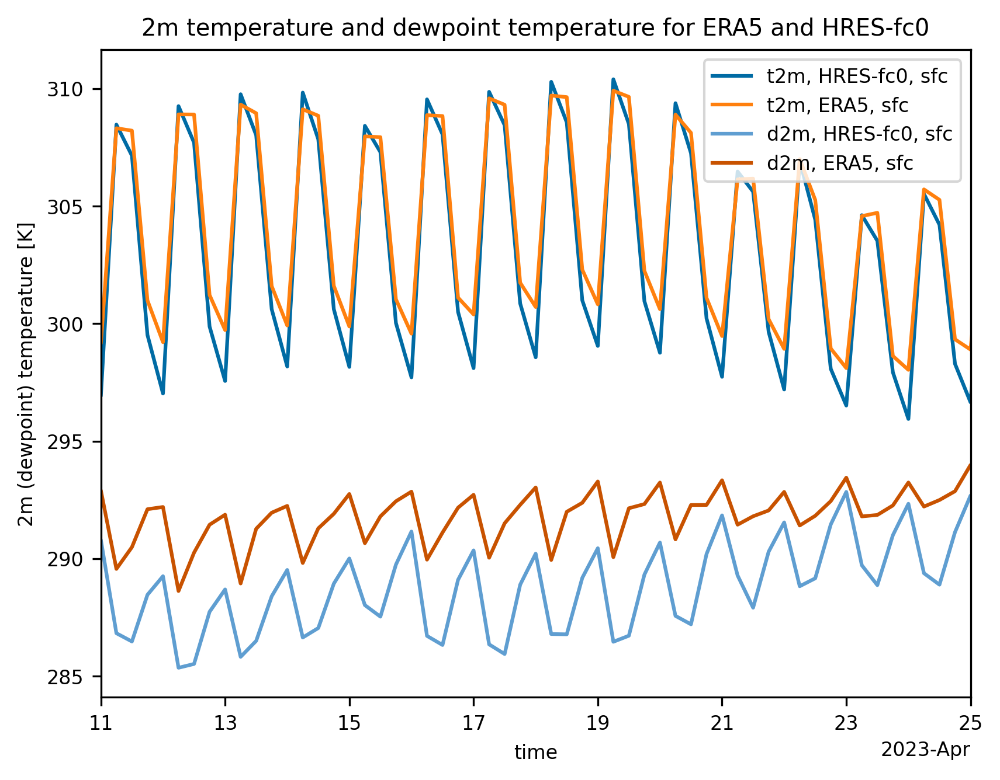

In [64]:
clip_data(
    gt_data.sel(source="HRES_t0", level=-1)["2m_temperature"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="t2m, HRES-fc0, sfc")

clip_data(gt_data.sel(source="ERA5", level=-1)["2m_temperature"], mask=masks[0]).mean(
    ("latitude", "longitude")
).plot(label="t2m, ERA5, sfc")

clip_data(
    gt_data.sel(source="HRES_t0", level=-1)["2m_dewpoint_temperature"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="d2m, HRES-fc0, sfc")

clip_data(
    gt_data.sel(source="ERA5", level=-1)["2m_dewpoint_temperature"], mask=masks[0]
).mean(("latitude", "longitude")).plot(label="d2m, ERA5, sfc")


plt.ylabel("2m (dewpoint) temperature [K]")

plt.xlim(np.datetime64("2023-04-11"), np.datetime64("2023-04-25"))
plt.legend()
plt.title("2m temperature and dewpoint temperature for ERA5 and HRES-fc0")

We also tested the raw data set and found the same differences there.